In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%matplotlib inline
import math
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import re
from collections import defaultdict
from scipy.stats.stats import pearsonr

In [ ]:
!ls drive/MyDrive/dm_dataset/
# !pip install pandas==1.3.4

country_codes.csv   height_dataset.csv	matches.pkl  tennis_matches.csv
female_players.csv  male_players.csv	players.pkl


# Data&nbsp;loading

In [ ]:
female = pd.read_csv('drive/MyDrive/dm_dataset/female_players.csv',  sep=r'\s*,\s*')
male = pd.read_csv('drive/MyDrive/dm_dataset/male_players.csv',  sep=r'\s*,\s*')
# matches = pd.read_csv('drive/MyDrive/dm_dataset/tennis_matches.csv',  sep=r'\s*,\s*')
matches = pd.read_pickle("drive/MyDrive/dm_dataset/matches.pkl")
# players = pd.read_pickle('players.pkl')
# players_stats = pd.read_pickle('player_matches.pkl')



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  


# Dataset Description & simple cleaning

### Basic info

In [ ]:
print(matches.shape)
print("Female Info:")
female.info()
print("\n")
print("Male Info:")
male.info()
print("\n")
print("Matches Info:")
matches.info()
print("\n")
matches.head()

(186128, 50)
Female Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46172 entries, 0 to 46171
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   name     44505 non-null  object
 1   surname  46172 non-null  object
dtypes: object(2)
memory usage: 721.6+ KB


Male Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55208 entries, 0 to 55207
Data columns (total 2 columns):
 #   Column   Non-Null Count  Dtype 
---  ------   --------------  ----- 
 0   name     55031 non-null  object
 1   surname  55166 non-null  object
dtypes: object(2)
memory usage: 862.8+ KB


Matches Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186128 entries, 0 to 186127
Data columns (total 50 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Unnamed: 0          186128 non-null  int64  
 1   tourney_id          186073 non-null  object 
 2   tourney_name        186103 non-nu

,Unnamed: 0,tourney_id,tourney_name,surface,draw_size,tourney_level,tourney_date,match_num,winner_id,winner_entry,winner_name,winner_hand,winner_ht,winner_ioc,winner_age,loser_id,loser_entry,loser_name,loser_hand,loser_ht,loser_ioc,loser_age,score,best_of,round,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,tourney_spectators,tourney_revenue
0,0,2019-M020,Brisbane,Hard,32.0,A,20181231.0,300.0,105453.0,NaN,Kei Nishikori,R,178.0,JPN,95.000000,106421.0,NaN,Daniil Medvedev,R,198.0,RUS,22.885695,6-4 3-6 6-2,3.0,F,124.0,3.0,3.0,77.0,44.0,31.0,17.0,13.0,3.0,6.0,8.0,6.0,100.0,54.0,34.0,20.0,14.0,10.0,15.0,9.0,3590.0,16.0,1977.0,3928.0,742618.69
1,1,2019-M020,Brisbane,Hard,32.0,A,20181231.0,299.0,106421.0,NaN,Daniil Medvedev,R,198.0,RUS,22.885695,104542.0,PR,Jo-Wilfried Tsonga,R,188.0,FRA,33.705681,7-6(6) 6-2,3.0,SF,82.0,10.0,1.0,52.0,33.0,28.0,14.0,10.0,0.0,1.0,17.0,2.0,77.0,52.0,36.0,7.0,10.0,10.0,13.0,16.0,1977.0,239.0,200.0,3928.0,742618.69
2,2,2019-M020,Brisbane,Hard,32.0,A,20181231.0,298.0,105453.0,NaN,Kei Nishikori,R,178.0,JPN,29.004791,104871.0,NaN,Jeremy Chardy,R,188.0,FRA,31.882272,6-2 6-2,3.0,SF,66.0,2.0,2.0,47.0,33.0,26.0,9.0,8.0,2.0,2.0,10.0,3.0,46.0,27.0,15.0,6.0,8.0,1.0,5.0,9.0,3590.0,40.0,1050.0,3928.0,742618.69
3,3,2019-M020,Brisbane,Hard,32.0,A,20181231.0,297.0,104542.0,PR,Jo-Wilfried Tsonga,R,188.0,FRA,33.705681,200282.0,NaN,Alex De Minaur,R,183.0,AUS,19.868583,6-4 7-6(2),3.0,QF,106.0,12.0,2.0,68.0,43.0,34.0,15.0,11.0,4.0,5.0,1.0,2.0,81.0,60.0,38.0,9.0,11.0,4.0,6.0,239.0,200.0,31.0,1298.0,3928.0,742618.69
4,4,2019-M020,Brisbane,Hard,32.0,A,20181231.0,296.0,106421.0,NaN,Daniil Medvedev,R,198.0,RUS,22.885695,105683.0,NaN,Milos Raonic,R,196.0,CAN,28.010951,6-7(2) 6-3 6-4,3.0,QF,129.0,12.0,3.0,105.0,68.0,48.0,25.0,16.0,8.0,8.0,29.0,5.0,94.0,56.0,46.0,19.0,15.0,2.0,4.0,16.0,1977.0,18.0,1855.0,3928.0,742618.69


### Missing value visualization

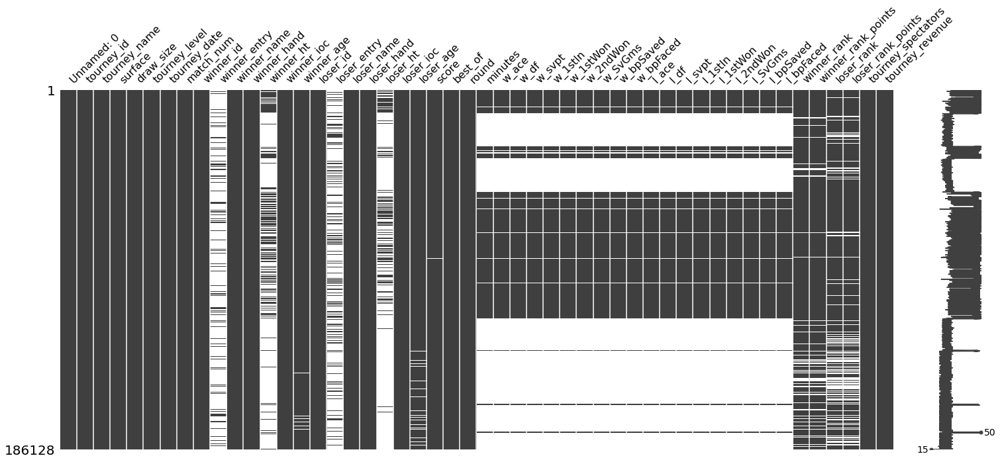

In [ ]:
!pip install missingno
import missingno as msno
fig = msno.matrix(matches)
fig_copy = fig.get_figure()
fig_copy.savefig('missigno.png', bbox_inches = 'tight')


### Cleaning

- We can delete the first column because its a count.  
- Then we are checking if the tourney_id or the tourney name can be merged in a single attribute.  
- 309 duplicates
- We have dropped the row with tourne_id null: this because we saw that they are duplicates of other matches in particular of Taipei.

We check if there are duplicated rows in the dataset:  
We found 309 duplicated rows and we drop them.
By checking the previus chart about missing value matrix we find that some rows has no value for tourney_id and the remaining feature all always equal to others rows. So we decided to drop them.

In [ ]:
#We removed the first column because is the count of the rows.
matches.drop(matches.columns[0],axis=1,inplace=True)
# print(matches[matches.duplicated()])
print("Number of duplicated rows: "+str(matches[matches.duplicated()].shape[0]))
matches = matches.drop_duplicates() # We remove the duplicated rows
print("Number of duplicated rows after drop: "+str(matches[matches.duplicated()].shape[0]))
print(matches.shape)
print(matches[matches.tourney_id.isna()].shape) # Number of rows with tourney_id null = 55
matches = matches.drop(matches[matches.tourney_id.isna()].index) #dropped the rows
print(matches[matches.tourney_id.isna()].shape)
print(matches.shape) # Final number of rows

Number of duplicated rows: 309
Number of duplicated rows after drop: 0
(185819, 49)
(55, 49)
(0, 49)
(185764, 49)


# Feature semantics & statistics

For the feature contained in the dataset we have found 3 principal macro groups:
- Match & tourney informations
- Player informations
- Player match performance statistics

## Match and tourney informations

### Tourney_id


In [ ]:
matches['tourney_id'].describe()

count       185764
unique        4853
top       2020-580
freq           478
Name: tourney_id, dtype: object

We can see that a lot of tourney id contain informations about the match leading to different ids for the same tourney.
We will address this problem later in the cleaning phase.
parsa id -> controlla stesso id e nome diverso
nel nome c'è scritto il round
davis cup: parsa nome fino a:
davis cup: PO R1 R2 R3 QF SF F
davis cup: WG (Finals dal 2019), WG1 WG2,, G1 G2, QLS
fed cup: WG, WG1 WG2, G1 G2
fed cup: parsa nome fino a:
fed cup si chiama bjk dal 2021

In [ ]:
matches[~(matches['tourney_name'].isna()) & (matches['tourney_name'].str.contains(':'))]

### Tourney_name

In [ ]:
matches['tourney_name'].describe()

count          185764
unique           2485
top       W15 Antalya
freq             4634
Name: tourney_name, dtype: object

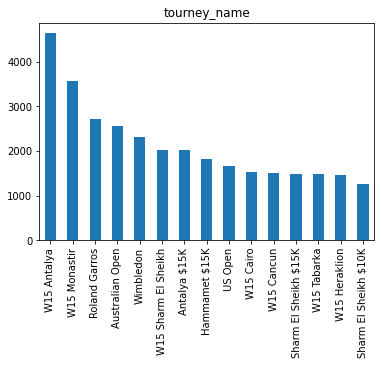

In [ ]:
matches.tourney_name.value_counts()[:15].plot(kind='bar',title='tourney_name')


### Surface

In [ ]:
matches['surface'].describe()

count     185602
unique         4
top         Hard
freq       94936
Name: surface, dtype: object

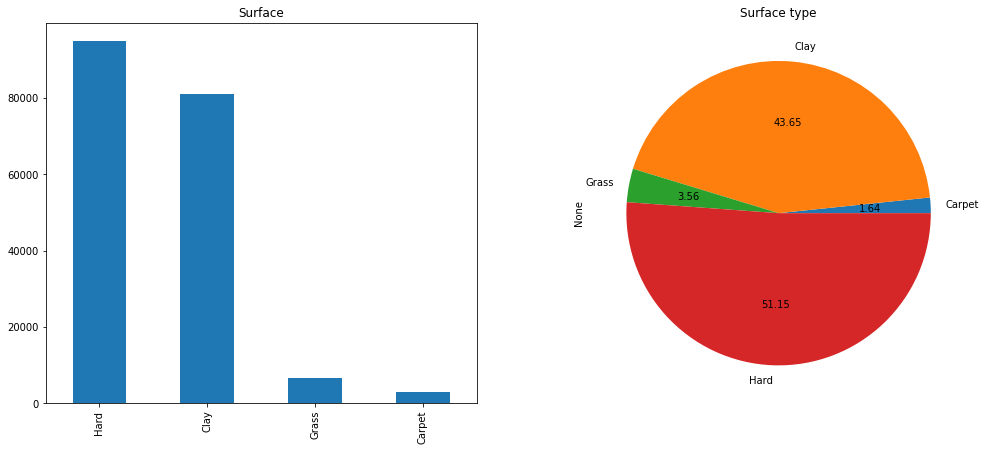

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(17,7))
matches.surface.value_counts().plot(kind='bar',title='Surface', ax=ax1)
matches.groupby('surface').size().plot(kind='pie', autopct='%.2f',title='Surface type',  ax=ax2)
plt.show()

In [ ]:
print(matches.surface.value_counts(dropna=False))
print()
print(matches.surface.value_counts(normalize=True))

Hard      94936
Clay      81013
Grass      6600
Carpet     3053
NaN         162
Name: surface, dtype: int64

Hard      0.511503
Clay      0.436488
Grass     0.035560
Carpet    0.016449
Name: surface, dtype: float64


### Draw_size

Number of players in the draw, often rounded up to the nearest power of 2. (For instance, a tournament with 28 players may be shown as 32.)

In [ ]:
matches['draw_size'].describe()

count    185764.000000
mean         41.050473
std          25.368106
min           2.000000
25%          32.000000
50%          32.000000
75%          32.000000
max         128.000000
Name: draw_size, dtype: float64

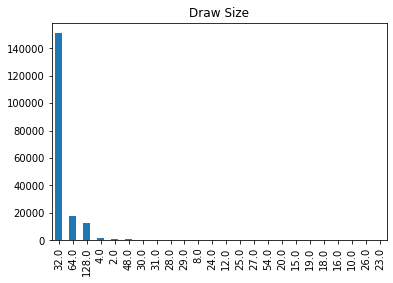

In [ ]:
matches.draw_size.value_counts().plot(kind='bar',title='Draw Size')
plt.show()

### Tourney_level

#### Semantics

Tourney level indentifies the type of tourney.  
These are used for both men and women only tourney:
- 'G' = Grand Slams  
- 'M' = Masters 1000s  
- 'A' = other tour-level
events  
- 'C' = Challengers  
- 'S' = Satellites/ITFs  
- 'F' = Tour finals and other
season-ending events  
- 'D' = Davis Cup

Then we have the ones used only for women tourney:  
- 'P' = Premier  
- 'PM' = Premier Mandatory  
- 'I' = International
-  The various levels
of ITFs are given by the prize money (in thousands), such as '15' = ITF
$15,000  
- Other codes, such as 'T1' for Tier I (and so on) are used for older
WTA tournament designations  
- 'D' is used for the Federation/Fed/Billie Jean
King Cup, and also for the Wightman Cup and Bonne Bell Cup.

There are also competitions wich can be both for men and women:
- 'E' =
exhibition (events not sanctioned by the tour, though the definitions can be
ambiguous)  
- 'J' = juniors  
- 'T' = team tennis



In the tourney_level we have O,W for which we cant find informations.

#### Statistics

In [ ]:
matches['tourney_level'].describe()

count     185764
unique        19
top           15
freq       45807
Name: tourney_level, dtype: object

In [ ]:
print("Distinct Values in tourney_level: \t", matches.tourney_level.value_counts(dropna=False))

Distinct Values in tourney_level: 	 15     45807
C      40530
25     30743
A      11678
10     11372
G       9981
I       8452
60      6517
P       5944
M       3877
100     2685
D       2373
80      1909
50      1488
PM      1478
W        436
F        211
75       155
O        128
Name: tourney_level, dtype: int64


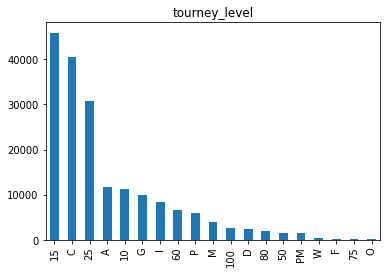

In [ ]:
matches.tourney_level.value_counts().plot(kind='bar',title='tourney_level')
plt.show()

### Tourney_date

In [ ]:
matches['tourney_date'].describe()

count    1.857640e+05
mean     2.018286e+07
std      1.608409e+04
min      2.016010e+07
25%      2.017052e+07
50%      2.018083e+07
75%      2.019101e+07
max      2.021082e+07
Name: tourney_date, dtype: float64

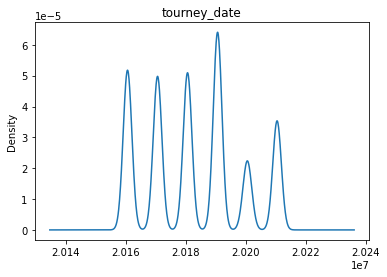

In [ ]:
matches.tourney_date.plot(kind='kde',title='tourney_date')
plt.show()

### Match_num

a match-specific identifier. Often starting from 1, sometimes counting
down from 300, and sometimes arbitrary.

In [ ]:
matches['match_num'].describe()

count    185764.000000
mean        160.464175
std         289.562750
min           1.000000
25%          17.000000
50%         130.000000
75%         272.000000
max        8312.000000
Name: match_num, dtype: float64

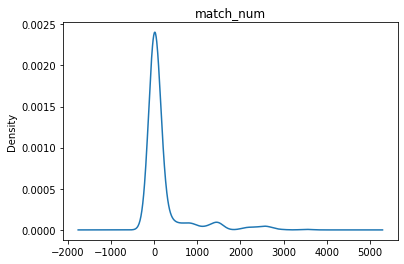

In [ ]:
matches.match_num.value_counts().plot(kind='kde',title='match_num')
plt.show()

### Score

It's the result of the match

In [ ]:
matches['score'].describe()

count      185595
unique       9630
top       6-3 6-4
freq         5372
Name: score, dtype: object

In [ ]:
print("Distinct Values in score: \t", matches["score"].value_counts(dropna=False))

Distinct Values in score: 	 6-3 6-4              5372
6-3 6-2              5256
6-4 6-4              5195
6-2 6-2              5094
6-3 6-3              4840
                     ... 
6-4 2-6 4-0 RET         1
6-4 6-1 3-6 6-2         1
6-7 6-4 6-4 6-4         1
6-7(4) 6-1 10-3         1
7-6(4) 2-6 [10-8]       1
Name: score, Length: 9631, dtype: int64


### Best_of

In [ ]:
matches.best_of.describe()

count    185764.000000
mean          3.034162
std           0.259146
min           3.000000
25%           3.000000
50%           3.000000
75%           3.000000
max           5.000000
Name: best_of, dtype: float64

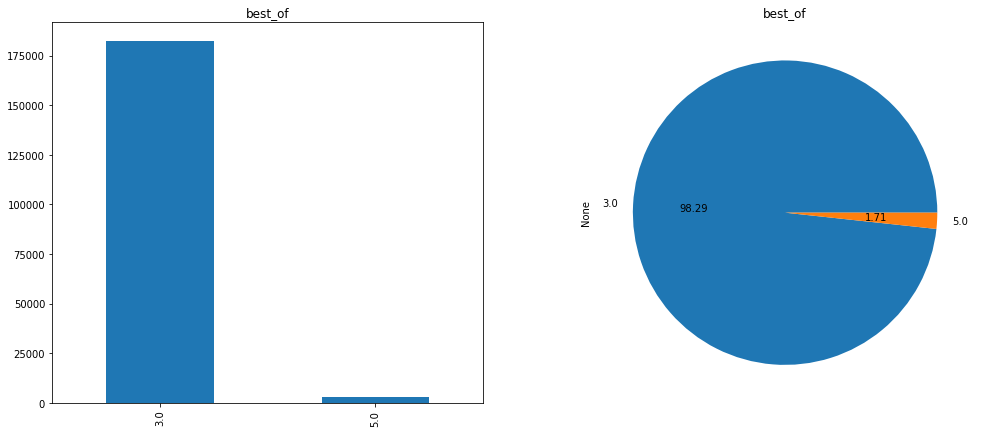

In [ ]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(17,7))
matches.best_of.value_counts().plot(kind='bar',title='best_of', ax=ax1)
matches.groupby('best_of').size().plot(kind='pie', autopct='%.2f',title='best_of',  ax=ax2)
plt.show()

### Round

#### Semantics

Round of a tournament prior to the quarterfinals in which there are 16 players remaining, corresponds to the fourth round of 128-draw tournament, the third round of a 64-draw, and second round of a 32-draw tournament.  
    - (W) Won; 
    - (F) finalist;  
    - (SF) semifinalist;  
    - (QF) quarterfinalist;  
    - (#R) rounds 4, 3, 2, 1;  
    - (RR) round-robin stage;  
    - (Q#) qualification round;  
    - (P#) preliminary round;  
    - (DNQ) did not qualify;  
    - (A) absent;  
    - (Z#) Davis/Fed Cup Zonal Group (with number indication) or (PO) play-off;   
    - (G) gold, (F-S) silver or (SF-B) bronze Olympic/Paralympic medal;   
    - a (NMS) downgraded Masters Series/1000 tournament;   
    - (P) postponed;   
    - (NH) not held. SR=strike rate (events won/competed)   
    - (RR): Tournament format in which players are organised into groups of three or four players and compete against all other members of the group. Players are then ranked according to number of matches, sets, and games won and head-to-head records. The top one, two, or four players then qualify for the next stage of the tournament.

As seen in the tourney_id some tourney have informations about the round in their name/id.
We will address this later in cleaning phase.

parsa id -> controlla stesso id e nome diverso
nel nome c'è scritto il round
davis cup: parsa nome fino a:
davis cup: PO R1 R2 R3 QF SF F
davis cup: WG (Finals dal 2019), WG1 WG2,, G1 G2, QLS
fed cup: WG, WG1 WG2, G1 G2
fed cup: parsa nome fino a:
fed cup si chiama bjk dal 2021

#### Statistics

In [ ]:
matches['round'].describe()

count     185764
unique        12
top          R32
freq       63060
Name: round, dtype: object

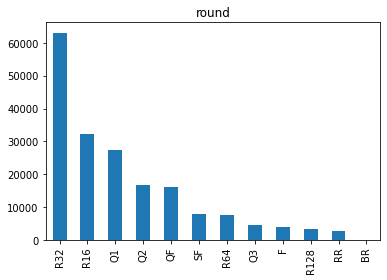

In [ ]:
matches['round'].value_counts().plot(kind='bar',title='round')
plt.show()

### Minutes

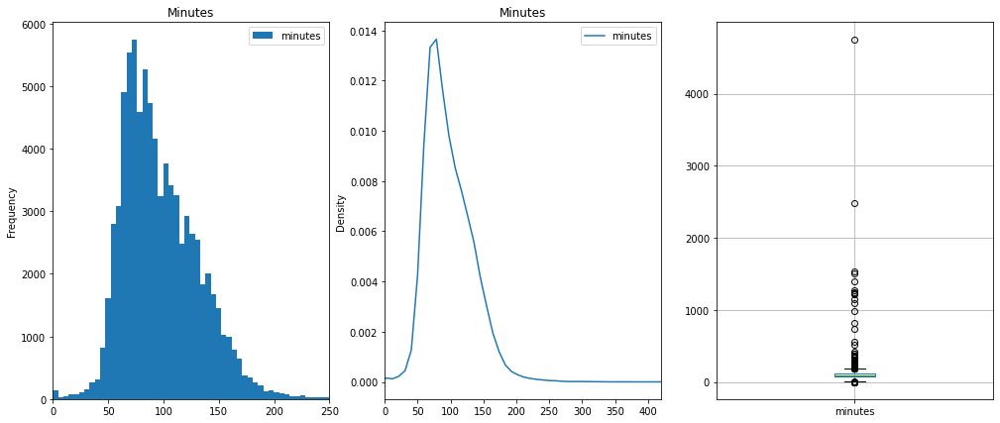

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['minutes'].plot.hist(title="Minutes", ax=ax1, bins=1000)
matches['minutes'].plot.kde(title="Minutes", ax=ax2)
matches.boxplot(column=['minutes'],ax=ax3)
matches.minutes.describe()
ax1.set_xlim(0,250)
ax2.set_xlim(0,420)
ax1.legend()
ax2.legend()
plt.show()


### Tourney_spectators

Spectators for the overall tourney

In [ ]:
matches.tourney_spectators.describe()

count    185764.000000
mean       4109.710078
std        2709.106905
min          91.000000
25%        2836.000000
50%        3340.000000
75%        4008.000000
max       18086.000000
Name: tourney_spectators, dtype: float64

count    185764.000000
mean       4109.710078
std        2709.106905
min          91.000000
25%        2836.000000
50%        3340.000000
75%        4008.000000
max       18086.000000
Name: tourney_spectators, dtype: float64


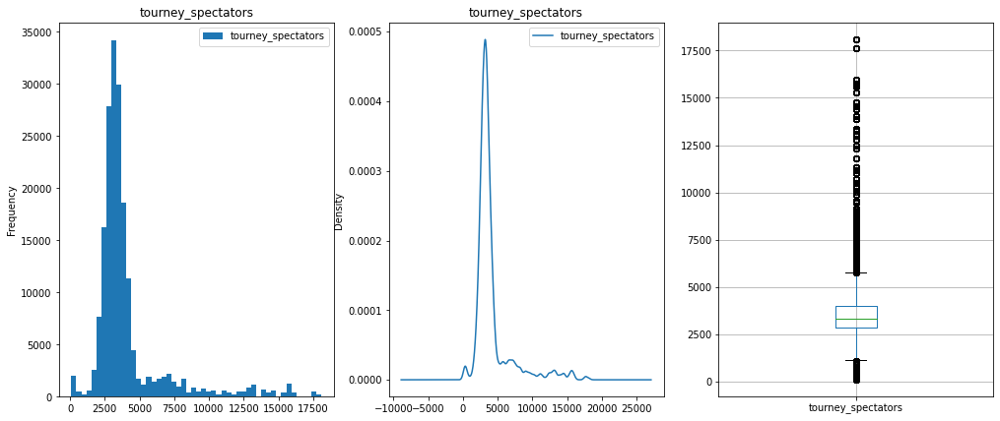

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['tourney_spectators'].plot.hist(title="tourney_spectators", ax=ax1, bins=50)
matches['tourney_spectators'].plot.kde(title="tourney_spectators", ax=ax2)
matches.boxplot(column=['tourney_spectators'],ax=ax3)
print(matches['tourney_spectators'].describe())
ax1.legend()
ax2.legend()
plt.show()

### Tourney_revenue

Total revenue of the tourney

In [ ]:
matches.tourney_revenue.describe()

count    1.857640e+05
mean     8.228694e+05
std      6.013153e+05
min      1.786574e+04
25%      5.473662e+05
50%      6.632303e+05
75%      8.342778e+05
max      5.002794e+06
Name: tourney_revenue, dtype: float64

count    1.857640e+05
mean     8.228694e+05
std      6.013153e+05
min      1.786574e+04
25%      5.473662e+05
50%      6.632303e+05
75%      8.342778e+05
max      5.002794e+06
Name: tourney_revenue, dtype: float64


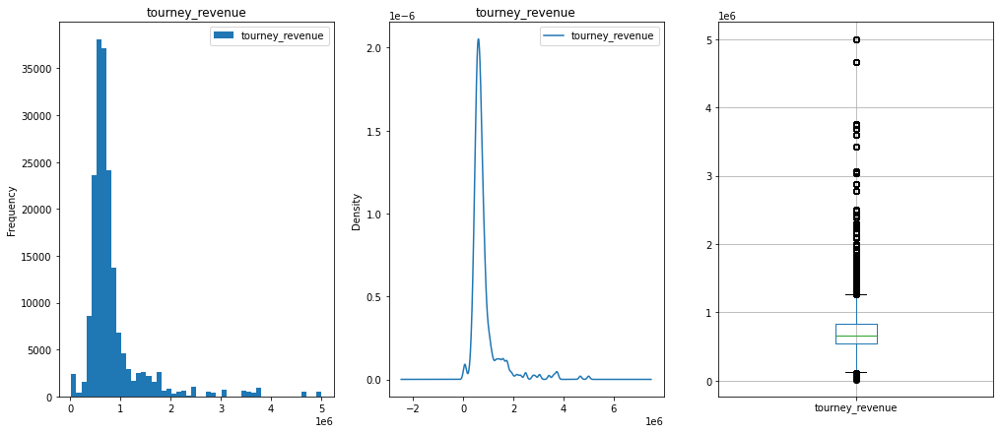

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['tourney_revenue'].plot.hist(title="tourney_revenue", ax=ax1, bins=50)
matches['tourney_revenue'].plot.kde(title="tourney_revenue", ax=ax2)
matches.boxplot(column=['tourney_revenue'],ax=ax3)
print(matches['tourney_revenue'].describe())
ax1.legend()
ax2.legend()
plt.show()

## Player's informations

In [ ]:
w = matches.filter(regex=("^w")).rename(columns=lambda x: re.sub('^w.*_', '', x))
w['tourney_date'] = matches['tourney_date'] # necessary for the future for computyng born date
l = matches.filter(regex=("^l")).rename(columns=lambda x: re.sub('^l.*_', '', x))
l['tourney_date'] = matches['tourney_date']
merged_matches = pd.concat((w,l)).rename(columns={'points':'rank_points'})


In [ ]:
merged_matches.columns

Index(['id', 'entry', 'name', 'hand', 'ht', 'ioc', 'age', 'ace', 'df', 'svpt',
       '1stIn', '1stWon', '2ndWon', 'SvGms', 'bpSaved', 'bpFaced', 'rank',
       'rank_points', 'tourney_date'],
      dtype='object')

### Id


In [ ]:
print(matches['winner_id'].describe())
print(matches['loser_id'].describe())
print(merged_matches['id'].describe())

count    185764.000000
mean     180105.888068
std       46571.821798
min      100644.000000
25%      122330.000000
50%      203526.000000
75%      214152.000000
max      245099.000000
Name: winner_id, dtype: float64
count    185764.000000
mean     181613.891987
std       46645.664816
min      100644.000000
25%      124079.000000
50%      205815.000000
75%      214818.000000
max      245099.000000
Name: loser_id, dtype: float64
count    371528.000000
mean     180859.890027
std       46614.793673
min      100644.000000
25%      123809.000000
50%      204268.000000
75%      214480.000000
max      245099.000000
Name: id, dtype: float64


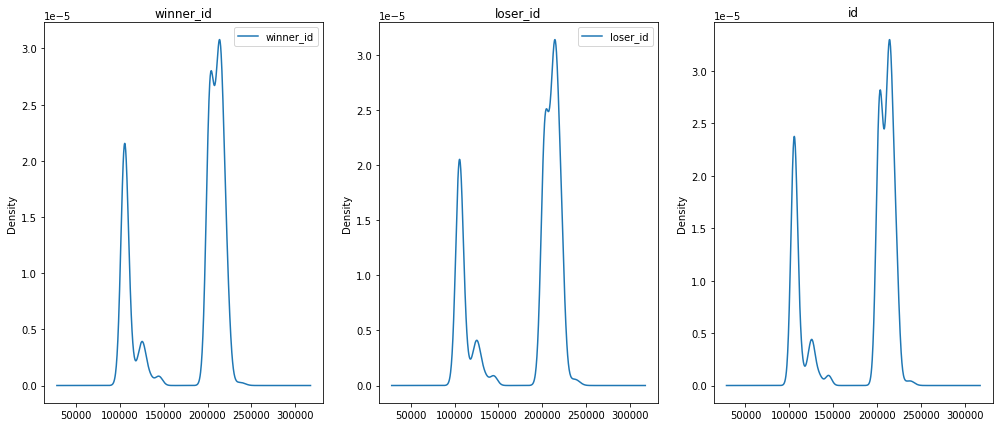

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_id'].plot.kde(title="winner_id", ax=ax1)
matches['loser_id'].plot.kde(title="loser_id", ax=ax2)
merged_matches['id'].plot.kde(title="id", ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

All the winner_name and loser_name have the id property.  
Then we checked if this ids are unique for the players or if some players may have different ids.

In [ ]:
print("Winner with null names with notnull ids:"+str(matches[(matches.winner_name.isna()) & (matches.winner_id.notna())].shape[0]))
print("Winner with notnull names with null ids:"+str(matches[(matches.winner_name.notna()) & (matches.winner_id.isna())].shape[0]))
print("Loser with nonnull names with null ids:"+str(matches[(matches.loser_name.notna()) & (matches.loser_id.isna())].shape[0]))
print("Loser with null names with nonnull ids:"+str(matches[(matches.loser_name.isna()) & (matches.loser_id.notna())].shape[0]))

alll = matches[matches.winner_name.notna()][['winner_name','winner_id']].rename(columns={'winner_name':'name','winner_id':'id'})
tmp = matches[matches.winner_name.notna()][['loser_name','loser_id']].rename(columns={'loser_name':'name','loser_id':'id'})
alll = pd.concat((alll, tmp)).drop_duplicates()


id_nomi = alll[['name','id']].groupby(["id"]).agg(lambda x: len(set(x)) == 1).reset_index()
print(id_nomi['name'].value_counts())
print()
names_id = alll[['name','id']].groupby(["name"]).agg(lambda x: len(set(x)) == 1).reset_index()
print(names_id['id'].value_counts())
print()

Winner with null names with notnull ids:0
Winner with notnull names with null ids:0
Loser with nonnull names with null ids:0
Loser with null names with nonnull ids:0
True     10025
False       49
Name: name, dtype: int64

True     10085
False       19
Name: id, dtype: int64



We see that 49 ids corrisponds to 98 people, but probably male and female are different so they can share the same id. We will address this later after the integration with names to insert the gender.

In [ ]:
print(alll[alll['id'].isin(id_nomi[id_nomi['name']==False]['id'])].sort_values('id').shape)
alll[alll['id'].isin(id_nomi[id_nomi['name']==False]['id'])].sort_values('id').head()

(98, 2)


,name,id
437,Serena Williams,200033.0
78458,Kushaan Nath,200033.0
162151,Liga Dekmeijere,202273.0
72621,Anurag Nenwani,202273.0
14540,Mariana Correa,202277.0


We can also see that to a name can correspond multiple ids.  
By searchin online on www.itftennis.com we can discriminate 2 tipes of duplicated id:
- Same person but different categories junior/Adult
- Different person with same name (homonyms).  

We could try to solve the first type by looking at the age of the player but missing values would be a problem so we chose to not solve those and instead we consider each id as an unique person

In [ ]:
print(alll[alll['name'].isin(names_id[names_id['id']==False]['name'])].sort_values('name').shape)
alll[alll['name'].isin(names_id[names_id['id']==False]['name'])].sort_values('name').head()

(38, 2)


,name,id
172168,Astrid Cirotte,223401.0
167668,Astrid Cirotte,236980.0
6213,Ekaterina Makarova,201505.0
51441,Ekaterina Makarova,223126.0
145085,Eleni Fasoula,222942.0


### Entry

winner/loser_entry:
- Alt/ALT -> Alternate  
- SE -> Special exempt  
- SR -> Special Ranking JE -> Junior Exemp  
- JR -> junior  


- In the winner/loser_entry we have A,P,3,I,IR,4,J,6 for which we cant find informations.

In [ ]:
print("Distinct Values in winner_entry: \t", matches.winner_entry.describe())
print("Distinct Values in loser_entry: \t", matches.loser_entry.describe())
print("Distinct Values in entry: \t", merged_matches.entry.describe())
print("Distinct Values in entry: \t", merged_matches.entry.value_counts(dropna=False))

Distinct Values in winner_entry: 	 count     25806
unique       15
top           Q
freq      13573
Name: winner_entry, dtype: object
Distinct Values in loser_entry: 	 count     44080
unique       19
top           Q
freq      20344
Name: loser_entry, dtype: object
Distinct Values in entry: 	 count     69886
unique       19
top           Q
freq      33917
Name: entry, dtype: object
Distinct Values in entry: 	 NaN    301642
Q       33917
WC      26237
LL       3132
SE       1341
Alt      1273
PR        974
ITF       729
ALT       612
IR        600
SR        427
JR        254
JE        248
A          84
P          52
I           2
J           1
3           1
4           1
6           1
Name: entry, dtype: int64


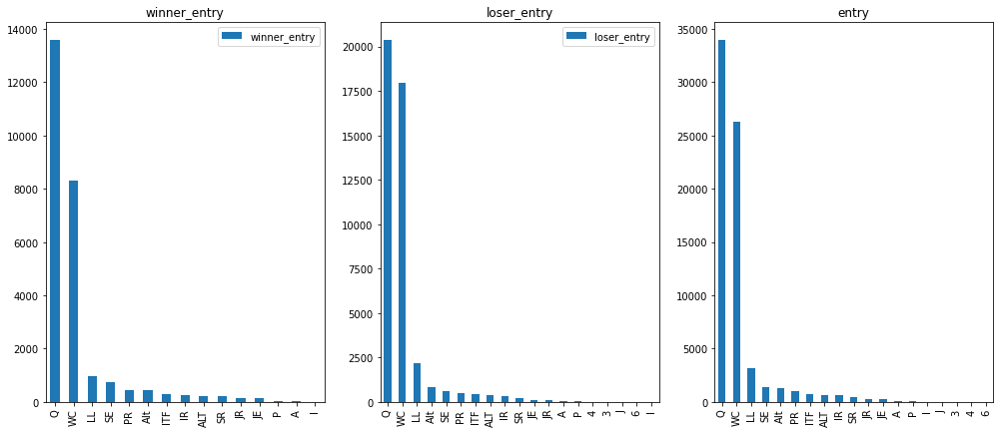

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_entry'].value_counts().plot.bar(title="winner_entry", ax=ax1)
matches['loser_entry'].value_counts().plot.bar(title="loser_entry", ax=ax2)
merged_matches['entry'].value_counts().plot.bar(title="entry", ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

### Name

In [ ]:
print("Distinct Values in winner_name: \t", matches.winner_name.describe())
print("Distinct Values in loser_name: \t", matches.loser_name.describe())
print("Distinct Values in name: \t", merged_matches.name.describe())

Distinct Values in winner_name: 	 count             185764
unique              6180
top       Novak Djokovic
freq                 289
Name: winner_name, dtype: object
Distinct Values in loser_name: 	 count            185764
unique            10060
top       Federico Gaio
freq                180
Name: loser_name, dtype: object
Distinct Values in name: 	 count          371528
unique          10104
top       Arantxa Rus
freq              387
Name: name, dtype: object


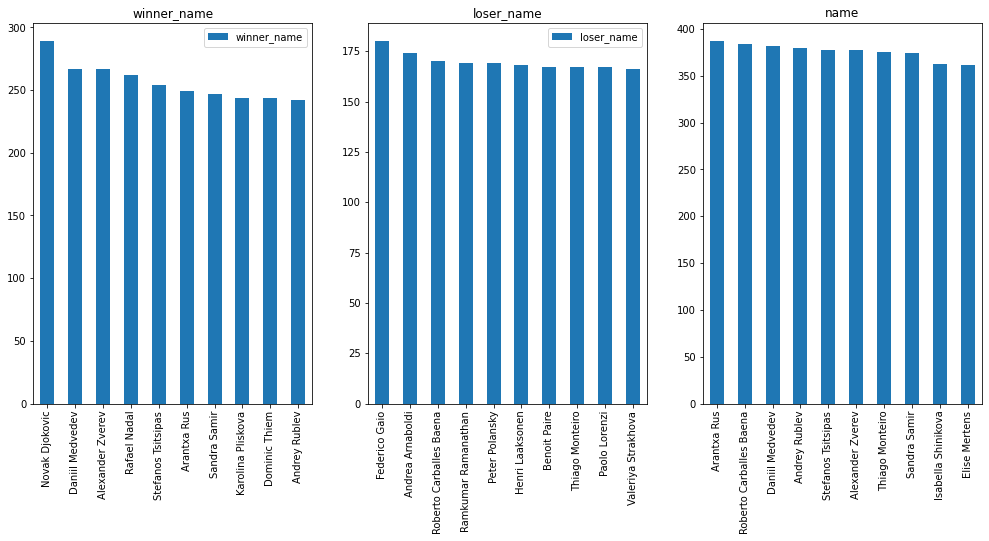

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_name'].value_counts()[:10].plot.bar(title="winner_name", ax=ax1)
matches['loser_name'].value_counts()[:10].plot.bar(title="loser_name", ax=ax2)
merged_matches['name'].value_counts()[:10].plot.bar(title="name", ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

### Ht

This also has to be seen when merging players

In [ ]:
print(matches['winner_ht'].describe())
print(matches['loser_ht'].describe())
print(merged_matches['ht'].describe())

count    49290.000000
mean       181.414749
std         11.631689
min          2.000000
25%        175.000000
50%        183.000000
75%        188.000000
max        211.000000
Name: winner_ht, dtype: float64
count    38326.000000
mean       181.566874
std         10.816129
min          2.000000
25%        175.000000
50%        183.000000
75%        188.000000
max        211.000000
Name: loser_ht, dtype: float64
count    87616.000000
mean       181.481293
std         11.282383
min          2.000000
25%        175.000000
50%        183.000000
75%        188.000000
max        211.000000
Name: ht, dtype: float64


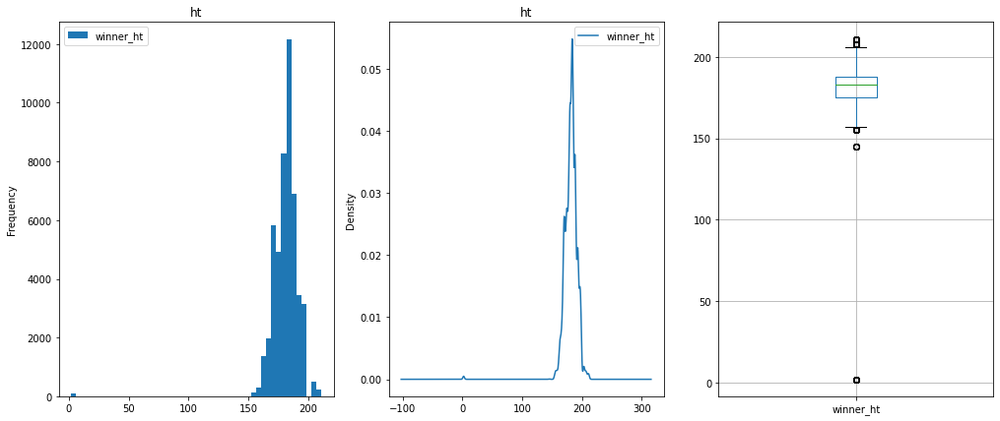

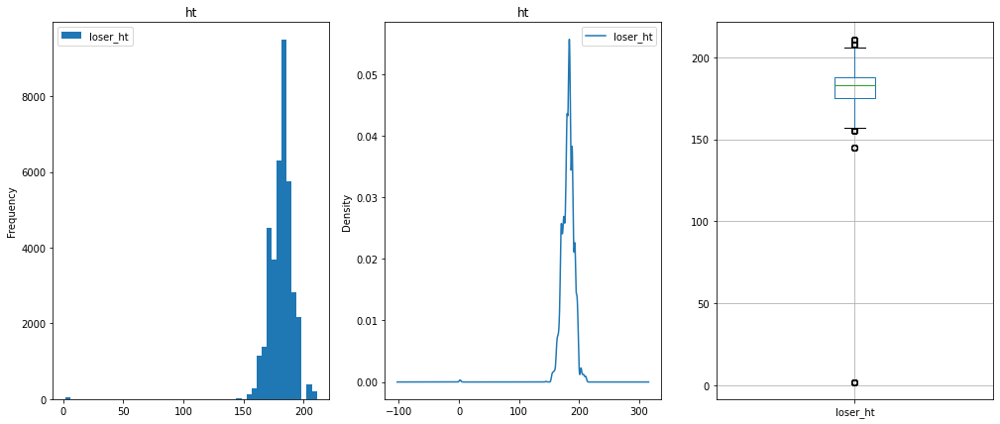

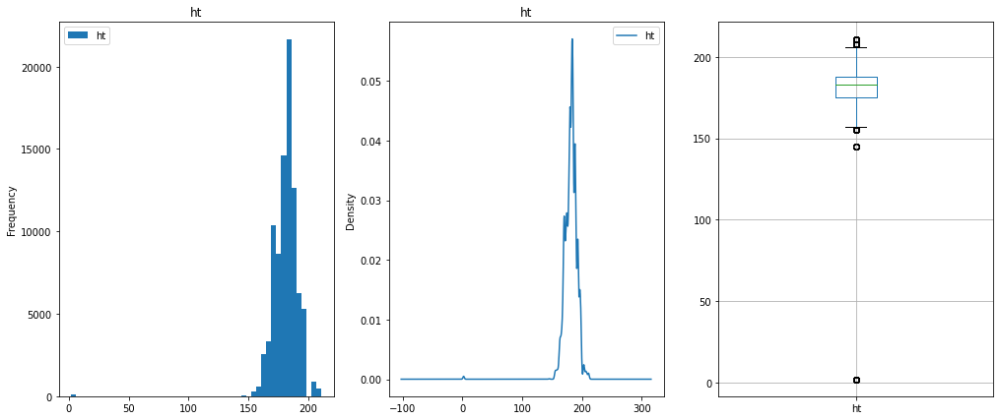

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_ht'].plot.hist(title="ht", ax=ax1, bins=50)
matches['winner_ht'].plot.kde(title="ht", ax=ax2)
matches.boxplot(column=['winner_ht'],ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['loser_ht'].plot.hist(title="ht", ax=ax1, bins=50)
matches['loser_ht'].plot.kde(title="ht", ax=ax2)
matches.boxplot(column=['loser_ht'],ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['ht'].plot.hist(title="ht", ax=ax1, bins=50)
merged_matches['ht'].plot.kde(title="ht", ax=ax2)
merged_matches.boxplot(column=['ht'],ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

### IOC

In [ ]:
print(matches['winner_ioc'].describe())
print(matches['loser_ioc'].describe())
print(merged_matches['ioc'].describe())

count     185764
unique       124
top          USA
freq       16393
Name: winner_ioc, dtype: object
count     185764
unique       154
top          USA
freq       16646
Name: loser_ioc, dtype: object
count     371528
unique       154
top          USA
freq       33039
Name: ioc, dtype: object


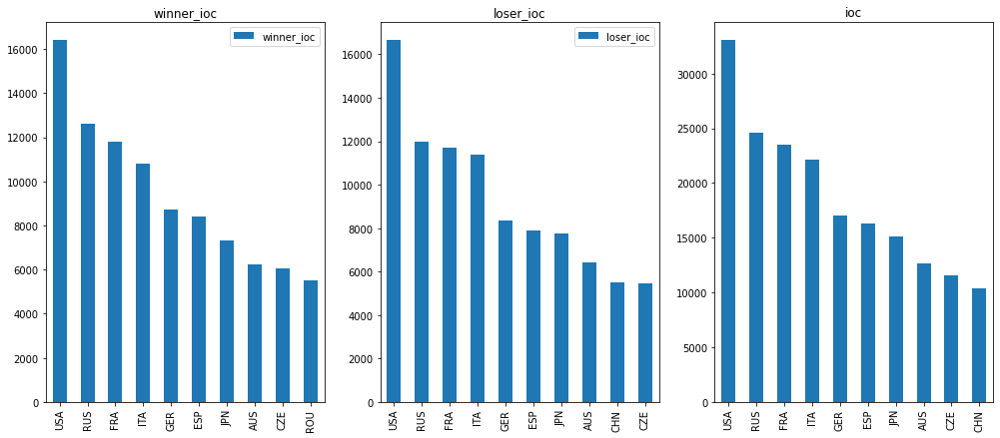

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_ioc'].value_counts()[:10].plot.bar(title="winner_ioc", ax=ax1)
matches['loser_ioc'].value_counts()[:10].plot.bar(title="loser_ioc", ax=ax2)
merged_matches['ioc'].value_counts()[:10].plot.bar(title="ioc", ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

### Age

In [ ]:
print(matches['winner_age'].describe())
print(matches['loser_age'].describe())
print(merged_matches['age'].describe())

count    182936.000000
mean         23.963072
std           4.463067
min          14.042437
25%          20.490075
50%          23.455168
75%          26.869268
max          95.000000
Name: winner_age, dtype: float64
count    179263.000000
mean         23.765087
std           4.630775
min          14.006845
25%          20.128679
50%          23.225188
75%          26.767967
max          74.485969
Name: loser_age, dtype: float64
count    362199.000000
mean         23.865083
std           4.547915
min          14.006845
25%          20.312115
50%          23.342916
75%          26.814511
max          95.000000
Name: age, dtype: float64


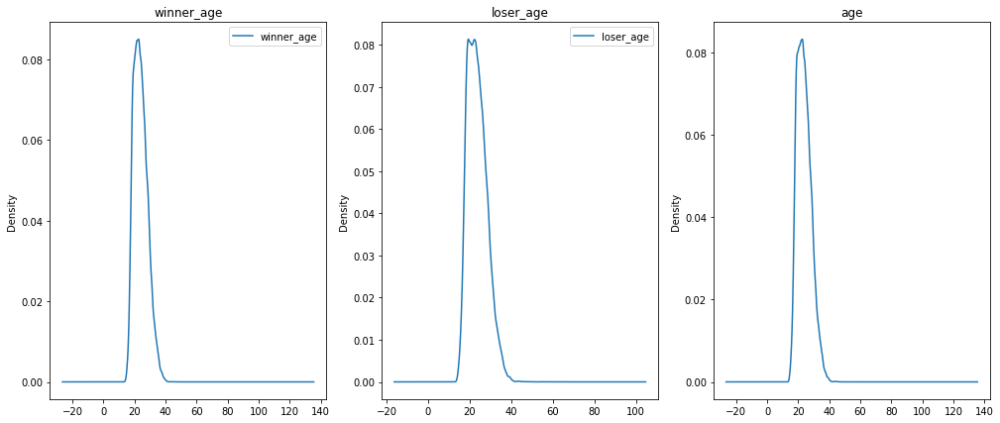

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_age'].plot.kde(title="winner_age", ax=ax1)
matches['loser_age'].plot.kde(title="loser_age", ax=ax2)
merged_matches['age'].plot.kde(title="age", ax=ax3)

ax1.legend()
ax2.legend()
plt.show()

## Player's match performance statistics

Since player match statistics are the same for winner and loser we merge them together

### Winner Ace

count    81982.000000
mean         4.823388
std          4.389558
min          0.000000
25%          2.000000
50%          4.000000
75%          7.000000
max         75.000000
Name: w_ace, dtype: float64


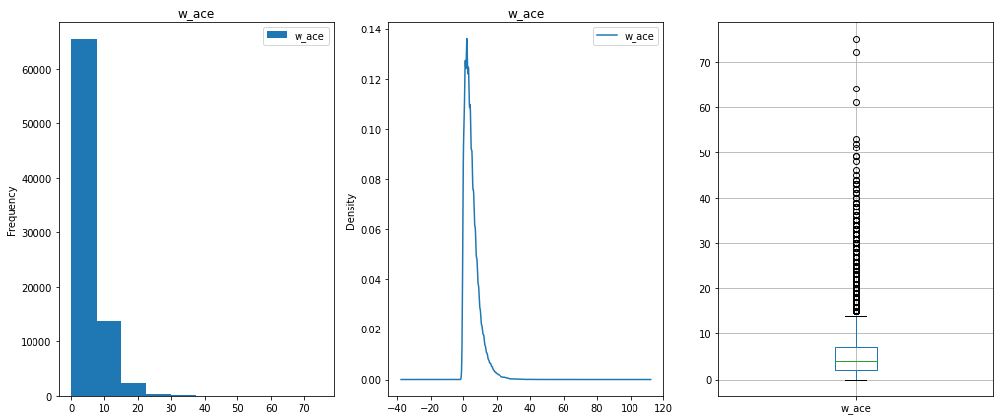

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_ace'].plot.hist(title="w_ace", ax=ax1)
matches['w_ace'].plot.kde(title="w_ace", ax=ax2)
matches.boxplot(column=['w_ace'],ax=ax3)
print(matches['w_ace'].describe())
ax1.legend()
ax2.legend()
plt.show()

### Loser Ace

count    81982.000000
mean         3.535422
std          3.831693
min          0.000000
25%          1.000000
50%          2.000000
75%          5.000000
max         67.000000
Name: l_ace, dtype: float64


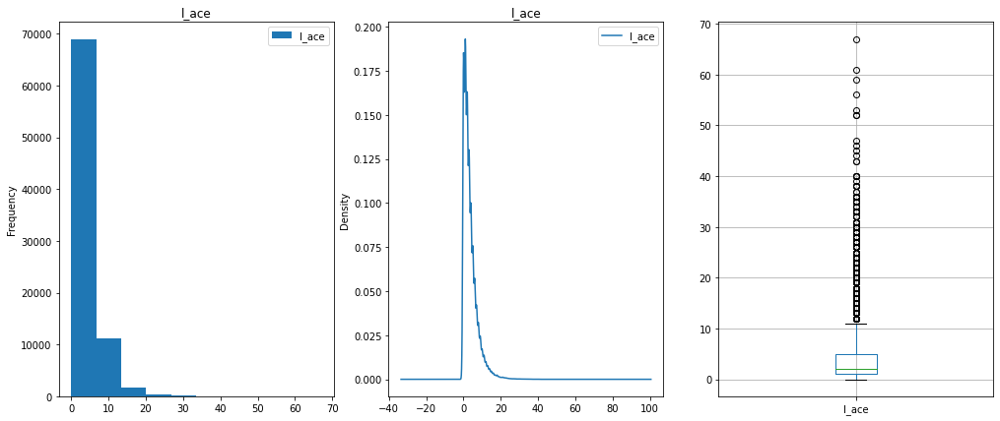

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_ace'].plot.hist(title="l_ace", ax=ax1)
matches['l_ace'].plot.kde(title="l_ace", ax=ax2)
matches.boxplot(column=['l_ace'],ax=ax3)
print(matches['l_ace'].describe())
ax1.legend()
ax2.legend()
plt.show()

### Winner Df

count    81982.000000
mean         2.855907
std          2.420502
min          0.000000
25%          1.000000
50%          2.000000
75%          4.000000
max        114.000000
Name: w_df, dtype: float64


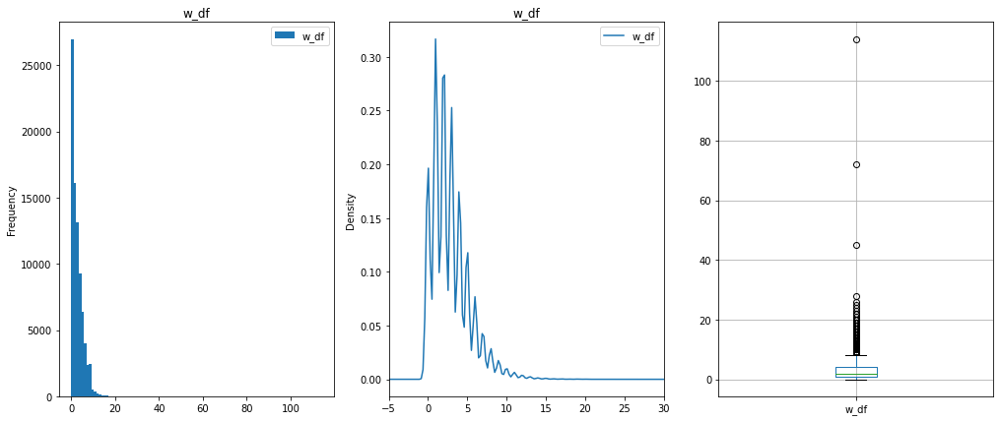

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_df'].plot.hist(title="w_df", ax=ax1, bins=100)
matches['w_df'].plot.kde(title="w_df", ax=ax2)
matches.boxplot(column=['w_df'],ax=ax3)
print(matches['w_df'].describe())
ax2.set_xlim(-5,30)
ax1.legend()
ax2.legend()
plt.show()

### Loser Df

count    81982.000000
mean         3.609365
std          2.606058
min          0.000000
25%          2.000000
50%          3.000000
75%          5.000000
max        114.000000
Name: l_df, dtype: float64


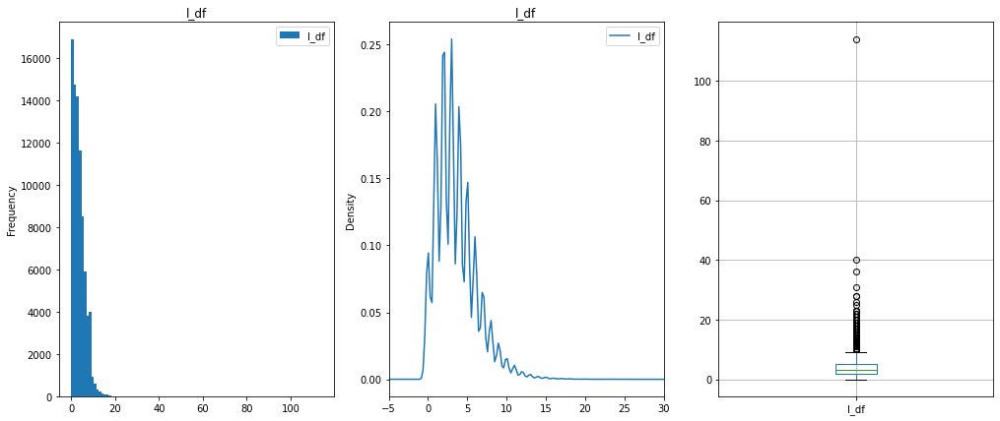

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_df'].plot.hist(title="l_df", ax=ax1, bins=100)
matches['l_df'].plot.kde(title="l_df", ax=ax2)
matches.boxplot(column=['l_df'],ax=ax3)
print(matches['l_df'].describe())
ax2.set_xlim(-5,30)
ax1.legend()
ax2.legend()
plt.show()

### Winner Df

count    81982.000000
mean        71.297004
std         25.530921
min          0.000000
25%         53.000000
50%         67.000000
75%         87.000000
max       1957.000000
Name: w_svpt, dtype: float64


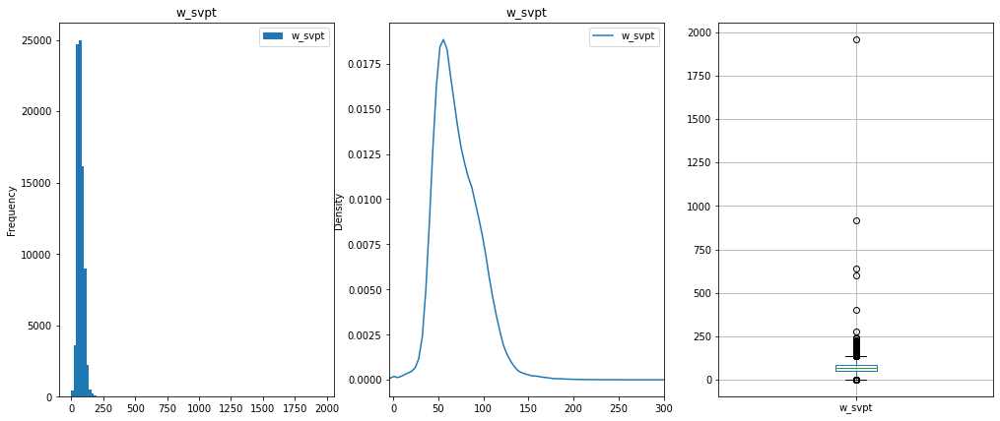

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_svpt'].plot.hist(title="w_svpt", ax=ax1, bins=100)
matches['w_svpt'].plot.kde(title="w_svpt", ax=ax2)
matches.boxplot(column=['w_svpt'],ax=ax3)
print(matches['w_svpt'].describe())
ax2.set_xlim(-5,300)
ax1.legend()
ax2.legend()
plt.show()

### Loser Df

count    81982.000000
mean        73.573297
std         24.996130
min          0.000000
25%         56.000000
50%         69.000000
75%         88.000000
max       1672.000000
Name: l_svpt, dtype: float64


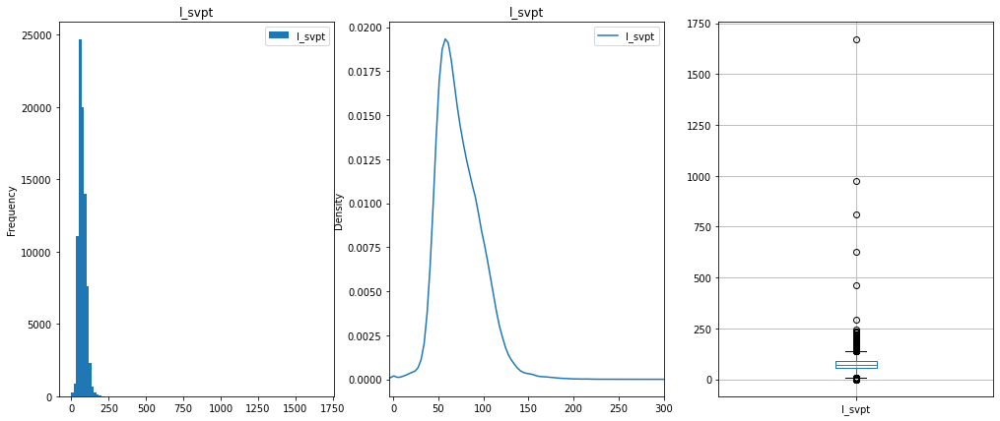

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_svpt'].plot.hist(title="l_svpt", ax=ax1, bins=100)
matches['l_svpt'].plot.kde(title="l_svpt", ax=ax2)
matches.boxplot(column=['l_svpt'],ax=ax3)
print(matches['l_svpt'].describe())
ax2.set_xlim(-5,300)
ax1.legend()
ax2.legend()
plt.show()

### Winner first In

count    81982.000000
mean        44.270901
std         16.950740
min          0.000000
25%         33.000000
50%         42.000000
75%         54.000000
max       1330.000000
Name: w_1stIn, dtype: float64


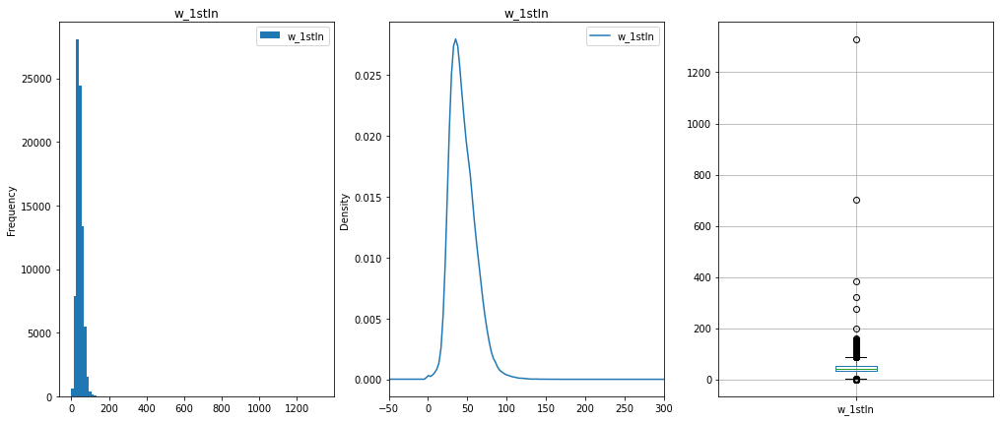

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_1stIn'].plot.hist(title="w_1stIn", ax=ax1, bins=100)
matches['w_1stIn'].plot.kde(title="w_1stIn", ax=ax2)
matches.boxplot(column=['w_1stIn'],ax=ax3)
print(matches['w_1stIn'].describe())
ax2.set_xlim(-50,300)
ax1.legend()
ax2.legend()
plt.show()

### Loser first In

count    81982.000000
mean        44.565112
std         16.777904
min          0.000000
25%         33.000000
50%         42.000000
75%         54.000000
max        893.000000
Name: l_1stIn, dtype: float64


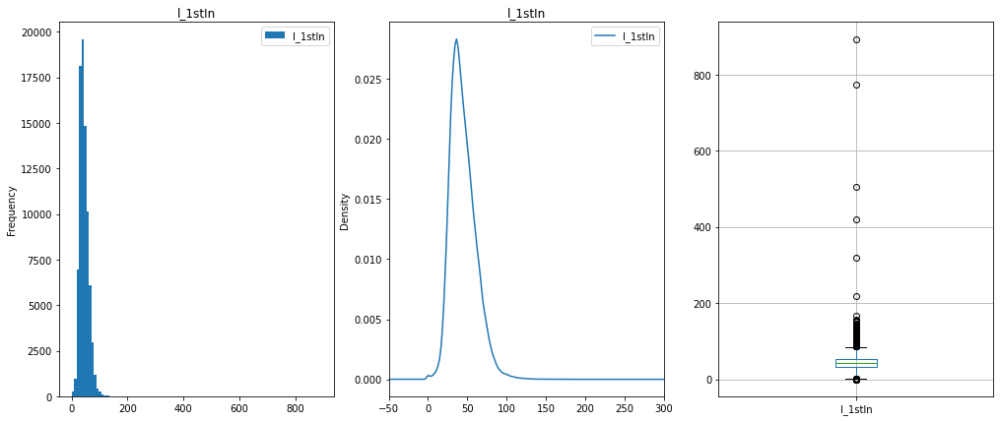

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_1stIn'].plot.hist(title="l_1stIn", ax=ax1, bins=100)
matches['l_1stIn'].plot.kde(title="l_1stIn", ax=ax2)
matches.boxplot(column=['l_1stIn'],ax=ax3)
print(matches['l_1stIn'].describe())
ax2.set_xlim(-50,300)
ax1.legend()
ax2.legend()
plt.show()

### Winner 1stWon

count    81982.000000
mean        32.142848
std         11.414119
min          0.000000
25%         24.000000
50%         30.000000
75%         38.000000
max        836.000000
Name: w_1stWon, dtype: float64


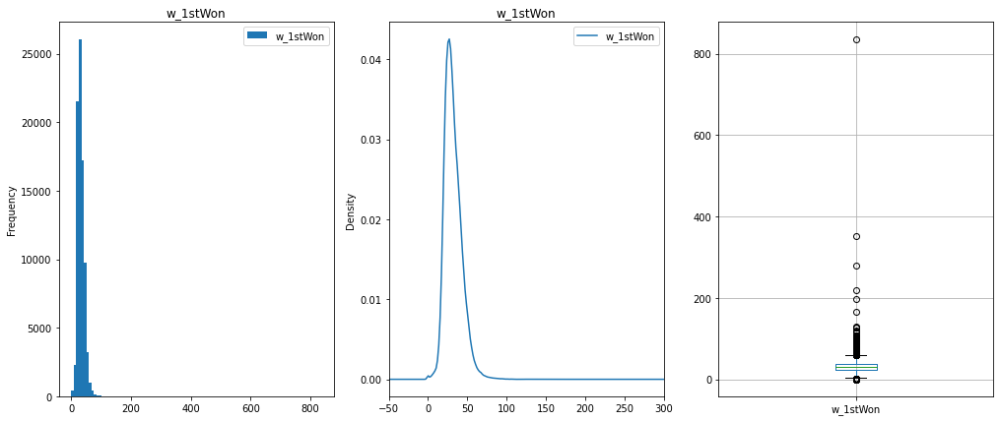

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_1stWon'].plot.hist(title="w_1stWon", ax=ax1, bins=100)
matches['w_1stWon'].plot.kde(title="w_1stWon", ax=ax2)
matches.boxplot(column=['w_1stWon'],ax=ax3)
print(matches['w_1stWon'].describe())
ax2.set_xlim(-50,300)
ax1.legend()
ax2.legend()
plt.show()

### Loser 1stWon

count    81982.000000
mean        32.142848
std         11.414119
min          0.000000
25%         24.000000
50%         30.000000
75%         38.000000
max        836.000000
Name: w_1stWon, dtype: float64


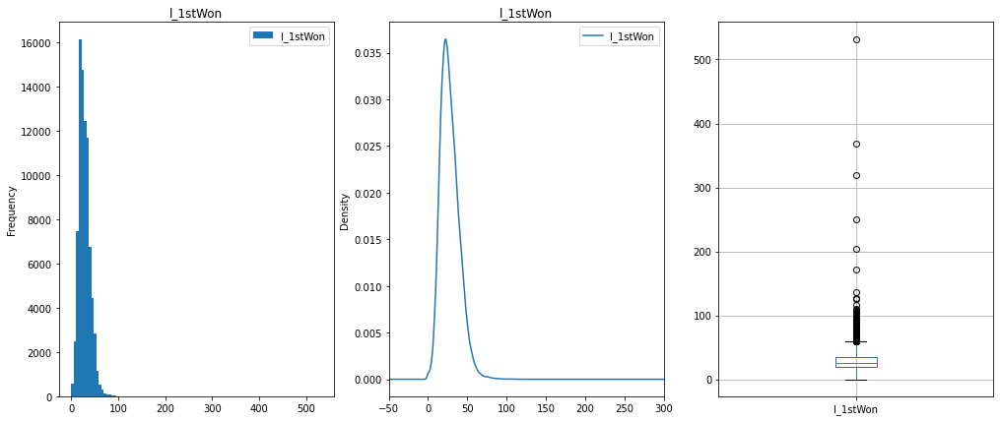

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_1stWon'].plot.hist(title="l_1stWon", ax=ax1, bins=100)
matches['l_1stWon'].plot.kde(title="l_1stWon", ax=ax2)
matches.boxplot(column=['l_1stWon'],ax=ax3)
print(matches['w_1stWon'].describe())
ax2.set_xlim(-50,300)
ax1.legend()
ax2.legend()
plt.show()

### Winner 2ndWon

count    81982.000000
mean        14.460662
std          5.935955
min          0.000000
25%         10.000000
50%         14.000000
75%         18.000000
max        304.000000
Name: w_2ndWon, dtype: float64


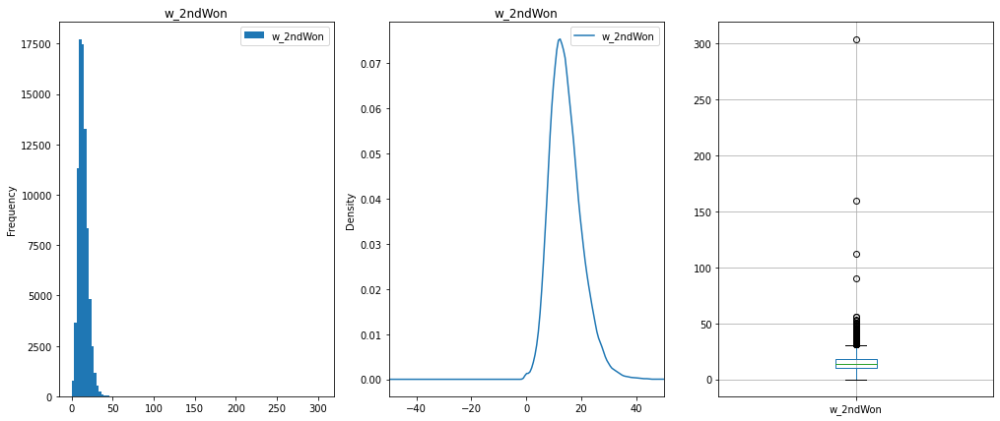

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_2ndWon'].plot.hist(title="w_2ndWon", ax=ax1, bins=100)
matches['w_2ndWon'].plot.kde(title="w_2ndWon", ax=ax2)
matches.boxplot(column=['w_2ndWon'],ax=ax3)
print(matches['w_2ndWon'].describe())
ax2.set_xlim(-50,50)
ax1.legend()
ax2.legend()
plt.show()

### Loser 2ndWon

count    81982.000000
mean        12.715657
std          6.322835
min          0.000000
25%          8.000000
50%         12.000000
75%         16.000000
max        399.000000
Name: l_2ndWon, dtype: float64


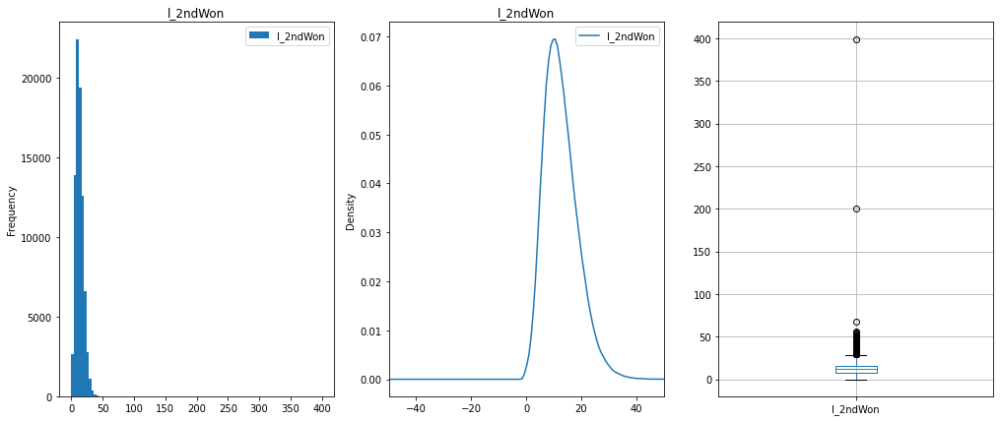

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_2ndWon'].plot.hist(title="l_2ndWon", ax=ax1, bins=100)
matches['l_2ndWon'].plot.kde(title="l_2ndWon", ax=ax2)
matches.boxplot(column=['l_2ndWon'],ax=ax3)
print(matches['l_2ndWon'].describe())
ax2.set_xlim(-50,50)
ax1.legend()
ax2.legend()
plt.show()

### Winner SvGms

count    81986.000000
mean        11.117337
std          3.514445
min          0.000000
25%          9.000000
50%         10.000000
75%         14.000000
max         49.000000
Name: w_SvGms, dtype: float64


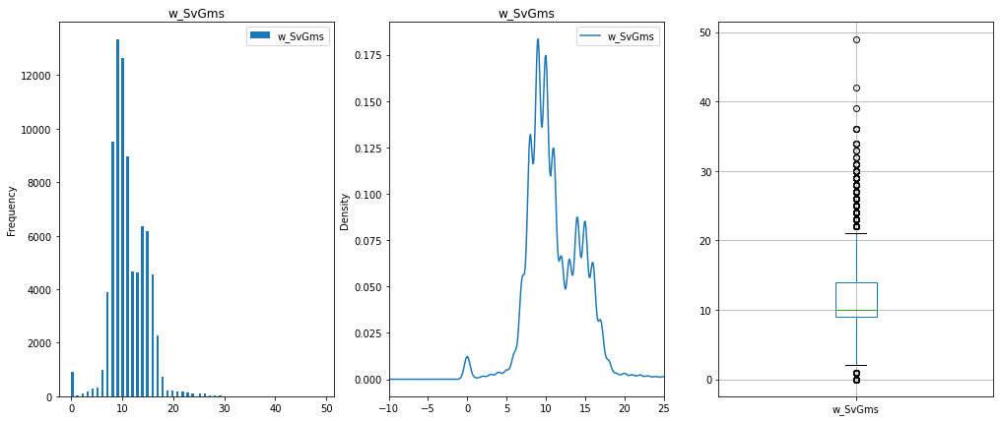

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_SvGms'].plot.hist(title="w_SvGms", ax=ax1, bins=100)
matches['w_SvGms'].plot.kde(title="w_SvGms", ax=ax2)
matches.boxplot(column=['w_SvGms'],ax=ax3)
print(matches['w_SvGms'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Loser SvGms

count    81986.000000
mean        10.942612
std          3.499454
min          0.000000
25%          9.000000
50%         10.000000
75%         13.000000
max         50.000000
Name: l_SvGms, dtype: float64


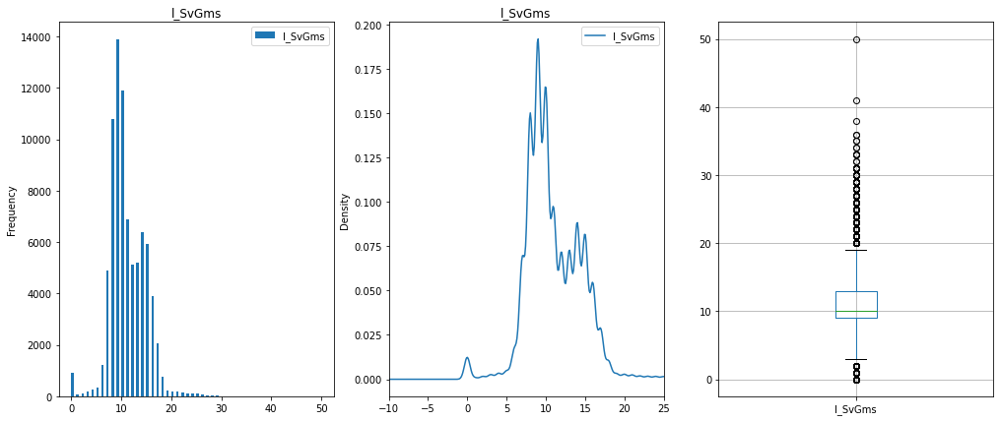

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_SvGms'].plot.hist(title="l_SvGms", ax=ax1, bins=100)
matches['l_SvGms'].plot.kde(title="l_SvGms", ax=ax2)
matches.boxplot(column=['l_SvGms'],ax=ax3)
print(matches['l_SvGms'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Winner bpSave

count    81982.000000
mean         3.538411
std          3.108513
min          0.000000
25%          1.000000
50%          3.000000
75%          5.000000
max        209.000000
Name: w_bpSaved, dtype: float64


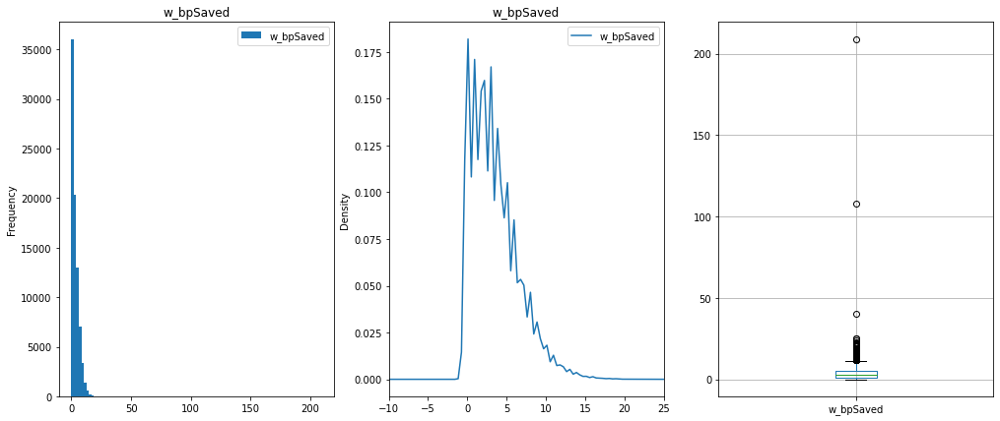

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_bpSaved'].plot.hist(title="w_bpSaved", ax=ax1, bins=100)
matches['w_bpSaved'].plot.kde(title="w_bpSaved", ax=ax2)
matches.boxplot(column=['w_bpSaved'],ax=ax3)
print(matches['w_bpSaved'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Loser bpSave

count    81982.000000
mean         4.658608
std          3.148033
min          0.000000
25%          2.000000
50%          4.000000
75%          6.000000
max        120.000000
Name: l_bpSaved, dtype: float64


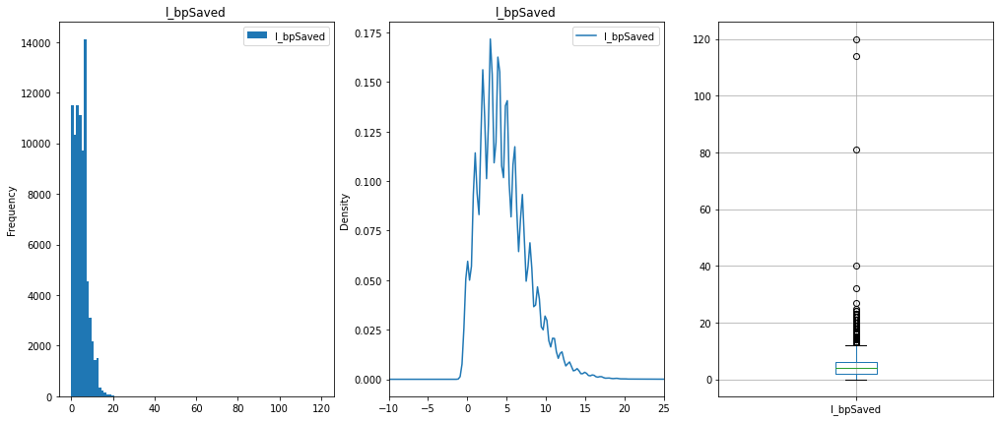

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_bpSaved'].plot.hist(title="l_bpSaved", ax=ax1, bins=100)
matches['l_bpSaved'].plot.kde(title="l_bpSaved", ax=ax2)
matches.boxplot(column=['l_bpSaved'],ax=ax3)
print(matches['l_bpSaved'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Winner w_bpFaced

count    81982.000000
mean         5.404137
std          4.204083
min          0.000000
25%          2.000000
50%          5.000000
75%          8.000000
max        266.000000
Name: w_bpFaced, dtype: float64


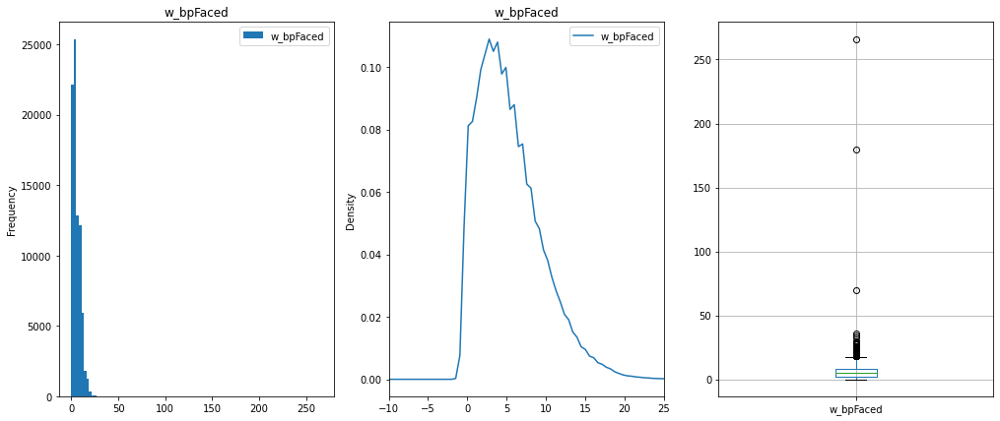

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['w_bpFaced'].plot.hist(title="w_bpFaced", ax=ax1, bins=100)
matches['w_bpFaced'].plot.kde(title="w_bpFaced", ax=ax2)
matches.boxplot(column=['w_bpFaced'],ax=ax3)
print(matches['w_bpFaced'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Loser w_bpFaced

count    81982.000000
mean         8.864238
std          3.967422
min          0.000000
25%          6.000000
50%          8.000000
75%         11.000000
max        190.000000
Name: l_bpFaced, dtype: float64


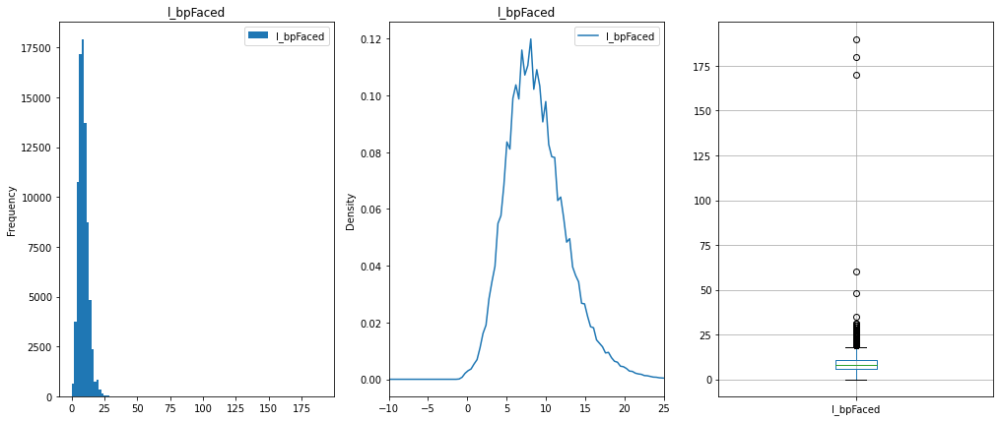

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['l_bpFaced'].plot.hist(title="l_bpFaced", ax=ax1, bins=100)
matches['l_bpFaced'].plot.kde(title="l_bpFaced", ax=ax2)
matches.boxplot(column=['l_bpFaced'],ax=ax3)
print(matches['l_bpFaced'].describe())
ax2.set_xlim(-10,25)
ax1.legend()
ax2.legend()
plt.show()

### Winner rank

count    166392.000000
mean        383.957919
std         314.201072
min           1.000000
25%         137.000000
50%         298.000000
75%         562.000000
max        2220.000000
Name: winner_rank, dtype: float64


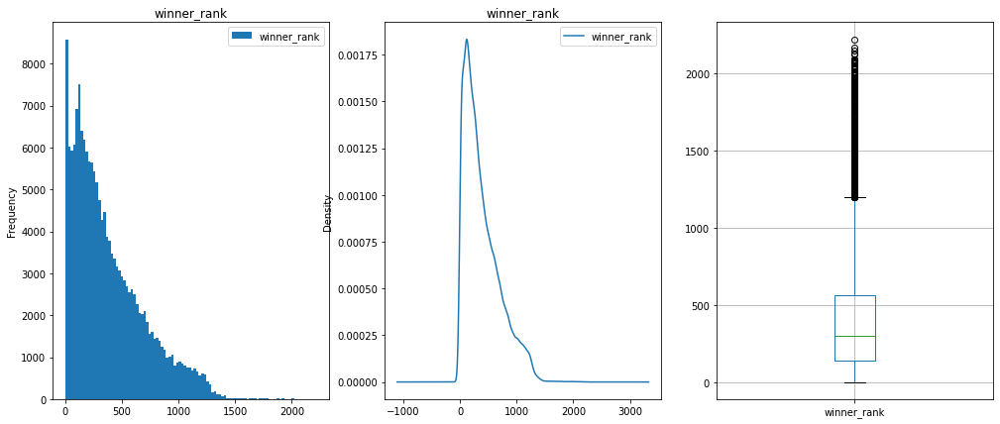

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_rank'].plot.hist(title="winner_rank", ax=ax1, bins=100)
matches['winner_rank'].plot.kde(title="winner_rank", ax=ax2)
matches.boxplot(column=['winner_rank'],ax=ax3)
print(matches['winner_rank'].describe())
ax1.legend()
ax2.legend()
plt.show()

### Loser rank

count    150532.000000
mean        434.321320
std         355.975553
min           1.000000
25%         156.000000
50%         325.000000
75%         642.000000
max        2257.000000
Name: loser_rank, dtype: float64


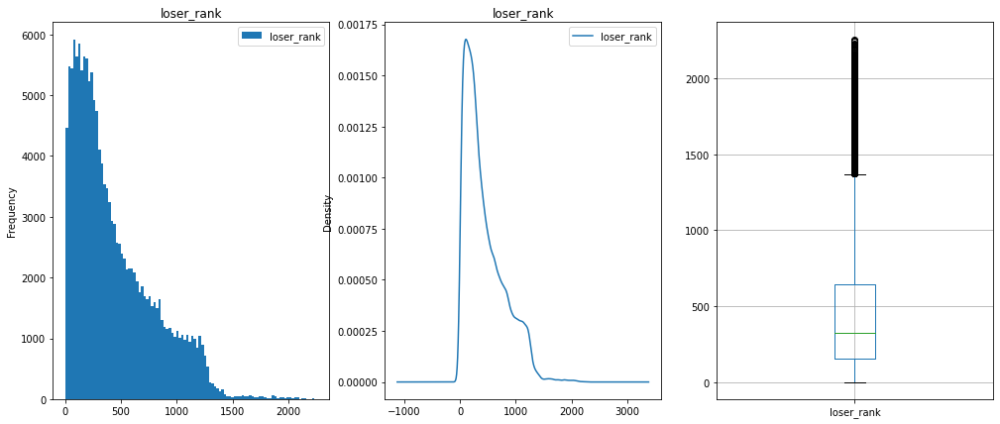

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['loser_rank'].plot.hist(title="loser_rank", ax=ax1, bins=100)
matches['loser_rank'].plot.kde(title="loser_rank", ax=ax2)
matches.boxplot(column=['loser_rank'],ax=ax3)
print(matches['loser_rank'].describe())
ax1.legend()
ax2.legend()
plt.show()

### Winner rank point

count    166376.000000
mean        470.958107
std        1041.945639
min           1.000000
25%          49.000000
50%         161.000000
75%         439.000000
max       16950.000000
Name: winner_rank_points, dtype: float64


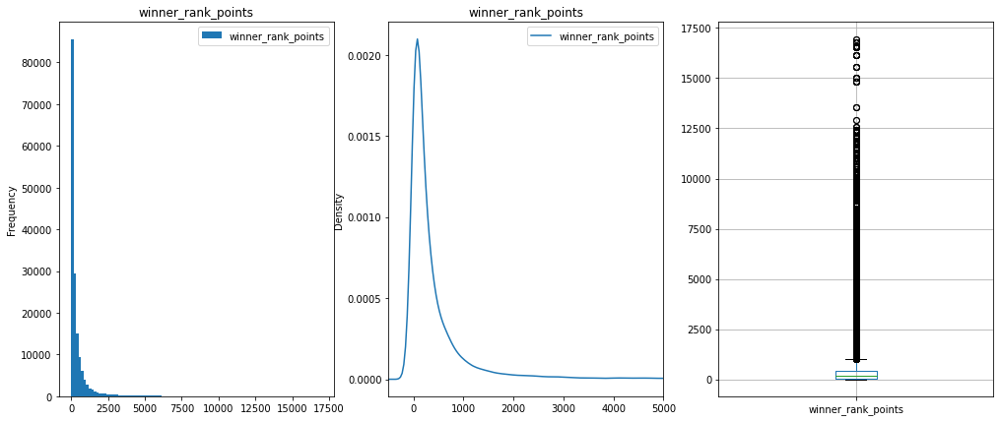

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['winner_rank_points'].plot.hist(title="winner_rank_points", ax=ax1, bins=100)
matches['winner_rank_points'].plot.kde(title="winner_rank_points", ax=ax2)
matches.boxplot(column=['winner_rank_points'],ax=ax3)
print(matches['winner_rank_points'].describe())
ax2.set_xlim(-500,5000)
ax1.legend()
ax2.legend()
plt.show()

### Loser rank point

count    150516.000000
mean        356.754518
std         703.270209
min           1.000000
25%          35.000000
50%         138.000000
75%         378.000000
max       16950.000000
Name: loser_rank_points, dtype: float64


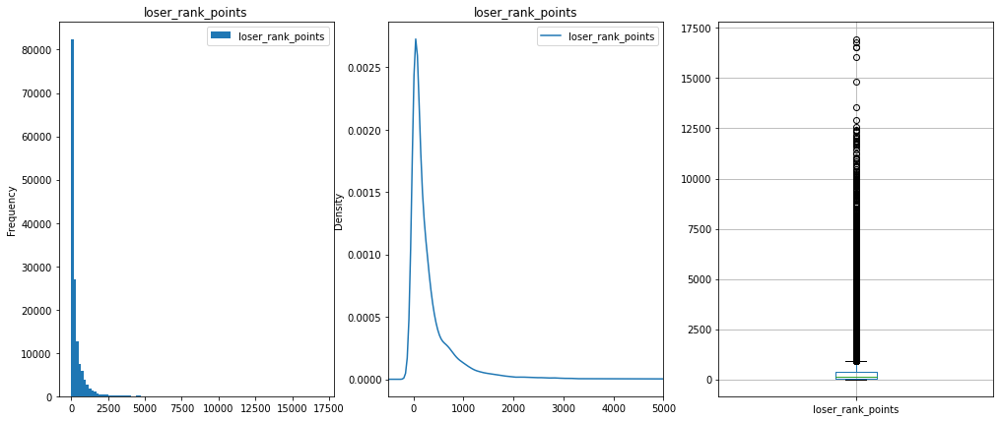

In [ ]:
fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['loser_rank_points'].plot.hist(title="loser_rank_points", ax=ax1, bins=100)
matches['loser_rank_points'].plot.kde(title="loser_rank_points", ax=ax2)
matches.boxplot(column=['loser_rank_points'],ax=ax3)
print(matches['loser_rank_points'].describe())
ax2.set_xlim(-500,5000)
ax1.legend()
ax2.legend()
plt.show()

# Data integration

We integrate the three dataset in one.

In [ ]:
male['name'] = male['name'].str.lower().str.replace(".","").str.strip()
male['surname'] = male['surname'].str.lower().str.replace(".","").str.strip()
female['name'] = female['name'].str.lower().str.replace(".","").str.strip()
female['surname'] = female['surname'].str.lower().str.replace(".","").str.strip()
matches['winner_name'] = matches['winner_name'].str.lower().str.replace(".","").str.strip().str.replace(r"  +", " ")
matches['loser_name'] = matches['loser_name'].str.lower().str.replace(".","").str.strip().str.replace(r"  +", " ")
female = female.drop(female[female['name'].isna() | (female['surname'].isna())].index)
male = male.drop(male[male['name'].isna() & (male['surname'].isna())].index)
male = male.drop(male[male['name'].isna() | (male['surname'].isna())].index)
female = female.drop_duplicates()
male = male.drop_duplicates()
male_names = male["name"]+" "+male["surname"]
female_names = female["name"]+" "+female["surname"]
print("Names inside female and male names:\n"+ str(male_names.isin(female_names).value_counts())+"\n") # 64
# Inserting gender inside the matches dataframe:
matches.loc[matches.winner_name.isin(male_names), 'w_gender'] = 'Male'
matches.loc[matches.loser_name.isin(male_names), 'l_gender'] = 'Male'
matches.loc[matches.winner_name.isin(female_names), 'w_gender'] = 'Female'
matches.loc[matches.loser_name.isin(female_names), 'l_gender'] = 'Female'

Names inside female and male names:
False    54487
True        64
dtype: int64



We have checked if there is some person (male and female at the same time).  
The result shows that 64 people are both in male names and female names.  
The gender for the one with full name can be inferred by looking to the name sex using an API, for the other instead we can use the torney code.

# Cleaning & Fixing

In [ ]:
print("Number of duplicated rows: "+str(matches[matches.duplicated()].shape[0]))
matches = matches.drop_duplicates() # We remove the duplicated rows
print("Number of duplicated rows after drop: "+str(matches[matches.duplicated()].shape[0]))
matches = matches.drop(matches[matches.tourney_id.isna()].index) #dropped the rows
print(matches.shape[0]) # Final number of rows

Number of duplicated rows: 0
Number of duplicated rows after drop: 0
185764


We check if there are duplicated rows in the dataset:  
We found 309 duplicated rows and we drop them.
By checking the previus chart about missing value matrix we find that some rows has no value for tourney_id and the remaining feature all always equal to others rows. So we decided to drop them.


In [ ]:
matches = matches[~((matches.w_svpt.isna())  & (matches.w_ace.isna()) & (matches.w_df.isna()) & (matches['w_1stIn'].isna()) & (matches['w_1stWon'].isna()) & (matches['w_bpFaced'].isna()))]
print(matches.shape[0])

81982


## Solving names

There are people who are not in male or female.
With this person we compute the Levenshtein distance to check if there are errors in the name. For each name we provide the best 3 names with lower distance.

In [ ]:
w = matches[(~matches.winner_name.isin(female_names)) & (~matches.winner_name.isin(male_names))]['winner_name'].unique() 
l = matches[(~matches.loser_name.isin(female_names)) & (~matches.loser_name.isin(male_names))]['loser_name'].unique()
t= np.unique(np.concatenate((w, l))) # Number of people that are not in female and male.
len(t)

26

In [ ]:
!pip install python-Levenshtein
import Levenshtein as lev
res = dict()
for name in t:
    res[str(name)] = []
    for n in male_names:
        val = lev.distance(str(name), str(n))
        res[str(name)].append(('Male',val, str(n)))
    for n in female_names:
        val = lev.distance(str(name), str(n))
        res[str(name)].append(('Female',val, str(n)))
    res[str(name)].sort(key=lambda x:x[1])
    res[str(name)] = res[str(name)][:3]
    print(name, res[str(name)])

alexandar lazov [('Male', 1, 'alexander lazov'), ('Male', 2, 'alexandar lazarov'), ('Male', 4, 'alexander lobkov')]
alona fomina [('Female', 1, 'alena fomina'), ('Female', 3, 'galina fokina'), ('Female', 4, 'elena bovina')]
andres artunedo martinavarro [('Male', 1, 'andres artunedo martinavarr'), ('Male', 11, 'andres pardo martinez'), ('Male', 13, 'andres navedo garcia')]
antoine hoang [('Male', 2, 'antonie hoang'), ('Male', 4, 'antoine hamard'), ('Male', 4, 'antoine monaco')]
ben patael [('Male', 1, 'ben fatael'), ('Male', 3, 'ben papell'), ('Male', 3, 'ben pauley')]
christopher o'connell [('Male', 1, 'christopher oconnell'), ('Male', 6, 'christopher condon'), ('Male', 6, 'christopher mengel')]
cristian garin [('Male', 1, 'christian garin'), ('Male', 2, 'cristian bogarin'), ('Male', 2, 'cristian garcia')]
daniel elahi galan [('Male', 7, 'daniel fiala'), ('Male', 7, 'daniel schalen'), ('Male', 7, 'daniel gagan')]
david o'hare [('Male', 1, 'david ohare'), ('Male', 3, 'david oleary'), ('

In [ ]:
correct_names_g = [
    ("alexandar lazov","alexander lazov","Male"),
    ("alona fomina","alena fomina","Female"),
    ("andres artunedo martinavarro",None,"Male"),
    ("antoine hoang",None,"Male"),
    ("ben patael",None,"Male"),
    ("christopher o'connell",None,"Male"),
    ("cristian garin",None,"Male"),
    ("daniel elahi galan",None,"Male"),
    ("david o'hare",None,"Male"),
    ("diego schwartzman",None,"Male"),
    ("evgenii tiurnev",None,"Male"),
    ("frances tiafoe",None,"Male"),
    ("franko skugor",None,"Male"),
    ("holger rune",None,"Male"),
    ("jj wolf",None,"Male"),
    ("jo-wilfried tsonga",None,"Male"),
    ("joao menezes",None,"Male"),
    ("juan pablo varillas",None,"Male"),
    ("jurabek karimov",None,"Male"),
    ("khumoun sultanov","khumoyun sultanov","Male"),
    ("lloyd harris",None, "Male"),
    ("pedro martinez",None, "Male"),
    ("sam groth","samuel groth", "Male"),
    ("stan wawrinka","stanislas wawrinka", "Male"),
    ("taylor fritz", None, "Male"),
    ("yu hsiang chiu",None, "Male"),
]
for it in correct_names_g:
    if it[1] is not None:
        matches.loc[matches.winner_name == it[0], 'winner_name'] = it[1]
        matches.loc[matches.loser_name == it[0], 'loser_name']   = it[1]
        matches.loc[matches.winner_name == it[1], 'w_gender'] = it[2] 
        matches.loc[matches.loser_name == it[1], 'l_gender'] = it[2] 
    else:
        matches.loc[matches.winner_name == it[0], 'w_gender'] = it[2] 
        matches.loc[matches.loser_name == it[0], 'l_gender'] = it[2]    

## Disambiguation gender by Opponent sex

For the unixes names we discriminate them with the matches looking at their opponent and the tourney level.
with the information about the matches we know that only player with the same sex can play in a match.
So with this assumption we can adjust the sex of the players that had a match with the oppenent with the opposite sex.

In [ ]:
matches[(((matches.w_gender=='Female') & (matches.l_gender=='Male'))|((matches.l_gender=='Female') & (matches.w_gender=='Male')))][['winner_name','winner_id', 'loser_name', 'loser_id', 'w_gender','l_gender','tourney_level', 'tourney_name', 'tourney_id']].sort_values('winner_name')


,winner_name,winner_id,loser_name,loser_id,w_gender,l_gender,tourney_level,tourney_name,tourney_id
65573,austin smith,106269.0,josh hagar hagar,136898.0,Female,Male,C,Winnetka CH,2016-0228
74382,axel michon,105678.0,kuan yi lee,134120.0,Male,Female,C,Kobe CH,2016-7397
103284,chun hsin tseng,202358.0,kuan yi lee,134120.0,Male,Female,C,Kaohsiung CH,2019-6490
83945,daniel altmaier,127157.0,kuan yi lee,134120.0,Male,Female,C,Bangkok CH,2017-7438
75283,danilo petrovic,105905.0,yang liu,202437.0,Male,Female,C,Qingdao CH,2016-7555
71990,enrique lopez perez,105782.0,kuan yi lee,134120.0,Male,Female,C,Shenzhen CH,2016-7004
65586,eric quigley,105281.0,austin smith,106269.0,Male,Female,C,Winnetka CH,2016-0228
80559,fajing sun,111806.0,kuan yi lee,134120.0,Male,Female,C,Bangkok CH,2017-5047
6801,hady habib,200273.0,kuan yi lee,134120.0,Male,Female,D,Davis Cup G2 R1: LBN vs TPE,2018-M-DC-2018-G2-AO-M-LBN-TPE-01
82124,hubert hurkacz,128034.0,kuan yi lee,134120.0,Male,Female,C,Shenzhen CH,2017-7004


In [ ]:
yang_name = 'yang liu'
matches.loc[matches.loser_name == yang_name, 'loser_id'] = yang_id = matches.winner_id.max() + matches.loser_id.max()
m_ids = [106269,134120, yang_id]
print(matches[matches.loser_id.isin(m_ids)].groupby(['loser_id', 'loser_name']).size())
matches[matches.winner_id.isin(m_ids)].groupby(['winner_id', 'winner_name']).size()

# Fixing the unisex names with opponent gender 
m_ids = [106269,134120, yang_id]
matches.loc[matches.winner_id.isin(m_ids),'w_gender'] = "Male"
matches.loc[matches.loser_id.isin(m_ids),'l_gender']  = "Male"
print("Mixed gender in a match:"+ str(matches[(((matches.w_gender=='Female') & (matches.l_gender=='Male'))|((matches.l_gender=='Female') & (matches.w_gender=='Male')))][['winner_name','winner_id', 'loser_name', 'loser_id', 'w_gender','l_gender','tourney_level', 'tourney_name', 'tourney_id']].sort_values('winner_name').shape[0]))

loser_id  loser_name  
106269.0  austin smith     3
134120.0  kuan yi lee     18
477620.0  yang liu         1
dtype: int64
Mixed gender in a match:0


## Differentiating female and male ids

Prefixing all female ids with 0, to solve the problems of before. (people with same name and different gender)

In [ ]:
matches['winner_id'] =  matches['winner_id'].astype(int).astype(str)
matches['loser_id'] =   matches['loser_id'].astype(int).astype(str)
matches.head()
matches.loc[matches.w_gender=='Female','winner_id'] = "0"+matches[matches.w_gender=='Female']['winner_id']
matches.loc[matches.l_gender=='Female','loser_id']  = "0"+matches[matches.l_gender=='Female']['loser_id']
matches[matches.l_gender=='Female']['loser_id']

27        0201540
28        0211880
29        0201611
30        0203389
31        0201521
           ...   
177499    0204420
177500    0205918
177501    0202653
177502    0214684
177503    0203435
Name: loser_id, Length: 23063, dtype: object

In [ ]:
# we recompute the new merged matches
w = matches.filter(regex=("^w")).rename(columns=lambda x: re.sub('^w.*_', '', x))
w['tourney_date'] = matches['tourney_date'] # necessary for the future for computyng born date
l = matches.filter(regex=("^l")).rename(columns=lambda x: re.sub('^l.*_', '', x))
l['tourney_date'] = matches['tourney_date']
merged_matches = pd.concat((w,l)).rename(columns={'points':'rank_points'})

## Minutes

count    81181.000000
mean        97.747182
std         41.478933
min          0.000000
25%         72.000000
50%         91.000000
75%        119.000000
max       4756.000000
Name: minutes, dtype: float64


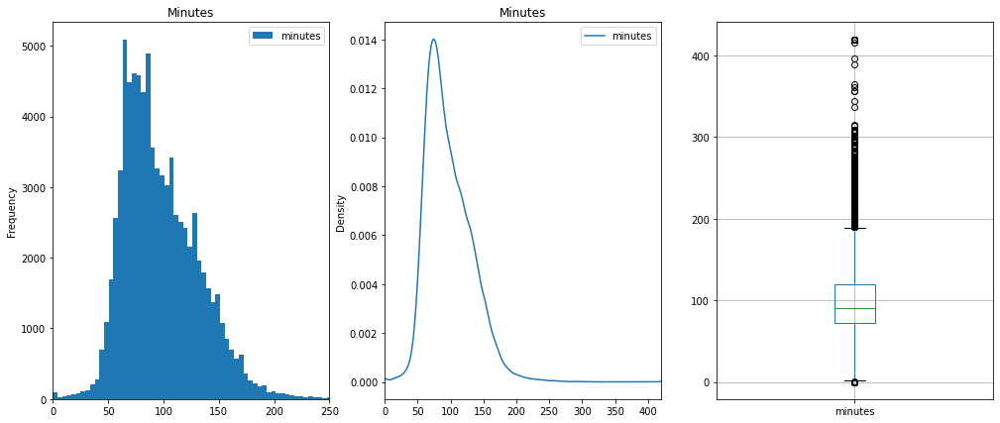

In [ ]:
print(matches['minutes'].describe())
matches.minutes.quantile(.95)

matches.loc[matches.minutes > 420, 'minutes'] = 420 # 7h

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
matches['minutes'].plot.hist(title="Minutes", ax=ax1, bins=100)
matches['minutes'].plot.kde(title="Minutes", ax=ax2)
matches.boxplot(column=['minutes'],ax=ax3)

ax1.set_xlim(0,250)
ax2.set_xlim(0,420)
ax1.legend()
ax2.legend()
plt.show()

On average, best-of-3 tennis matches last about 90 minutes, while best-of-5 matches last 2 hours and 45 minutes. The fastest professional tennis matches ever lasted about 20 minutes, while the longest match ever extended for a historic 11 hours and 5 minutes. Information taken from https://mytennishq.com/how-long-do-tennis-matches-last/#:~:text=On%20average%2C%20best%2Dof%2D,11%20hours%20and%205%20minutes.  
And we can see that our mean 97 is coherent with that information because most of the matches are best of 3.

We can see in https://en.wikipedia.org/wiki/Longest_tennis_match_records that the longest tennis match possible for our dataset (matches from 2016 to 2021) has a duration of ~7h 420 minutes so we use this as value for the outliers on minutes.

In [ ]:
print(matches[(matches.minutes == 0)& (matches.minutes.notna()) & ((matches.score != 'W/O')|(matches.score != 'Walkover'))].shape[0])
matches.loc[(matches.minutes == 0)& (matches.minutes.notna()) & ((matches.score != 'W/O')|(matches.score != 'Walkover')),'minutes'] = matches.minutes.median()
print(matches[(matches.minutes == 0)& (matches.minutes.notna()) & ((matches.score != 'W/O')|(matches.score != 'Walkover'))].shape[0])

87
0


There are a few matches with 0 minutes without having the score W/O that means victory without play. For these cases we choose to use the median to adjust this errors.

## Surface

Hard      47181
Clay      29525
Grass      5148
NaN         117
Carpet       11
Name: surface, dtype: int64

Hard      0.576327
Clay      0.360655
Grass     0.062884
Carpet    0.000134
Name: surface, dtype: float64


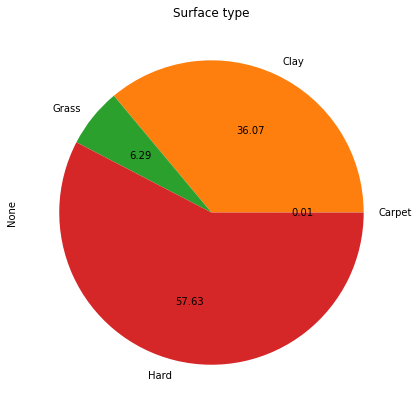

In [ ]:
print(matches.surface.value_counts(dropna=False))
print()
print(matches.surface.value_counts(normalize=True))
matches.groupby('surface').size().plot(kind='pie', autopct='%.2f',title='Surface type', figsize=(7,7))
plt.show()

We have decided to do sampling with this missing values because they are very few just 117 over 81982 so it is reasonable to sample that by mantainig the percentages of the surfaces.

In [ ]:
import random
probabs = matches.surface.value_counts(normalize=True).values
for index, row in matches.iterrows():
    if pd.isna(row['surface']):
        val = random.uniform(0, 1)
        surface = 'Carpet' if (val<probabs[3]) else 'Grass' if(probabs[3]<val<probabs[2]) else 'Clay' if(probabs[2]<val<probabs[1]) else 'Hard'
        matches.loc[index,'surface'] = surface
print(matches[matches.surface.isna()].shape[0])

0


Hard      47254
Clay      29563
Grass      5154
Carpet       11
Name: surface, dtype: int64


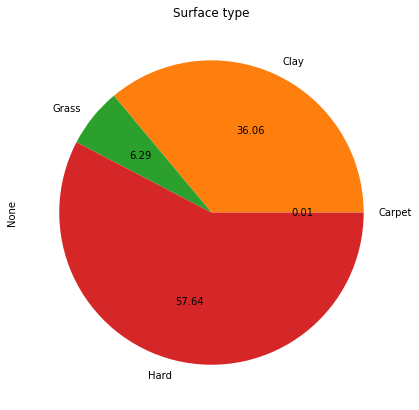

In [ ]:
matches.groupby('surface').size().plot(kind='pie', autopct='%.2f',title='Surface type', figsize=(7,7))
print(matches.surface.value_counts(dropna=False))

## Aces

count    163964.000000
mean          3.984978
std           3.645675
min           0.000000
25%           1.000000
50%           3.000000
75%           6.000000
max          19.000000
Name: ace, dtype: float64


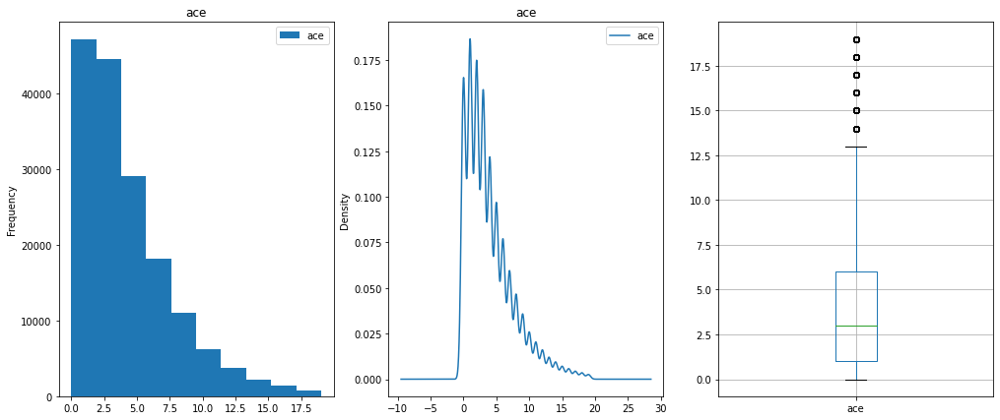

In [ ]:
#Solving outliers with median.
ace_median = merged_matches.ace.median()
matches.loc[matches['w_ace'] > 19, 'w_ace'] = ace_median
matches.loc[matches['l_ace'] > 19, 'l_ace'] = ace_median
merged_matches.loc[merged_matches['ace'] > 19,'ace'] = ace_median

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['ace'].plot.hist(title="ace", ax=ax1)
merged_matches['ace'].plot.kde(title="ace", ax=ax2)
merged_matches.boxplot(column=['ace'],ax=ax3)
print(merged_matches['ace'].describe())
ax1.legend()
ax2.legend()
plt.show()

https://www.atptour.com/en/stats/aces  
According to this website we can see that the top player Ivo Karlovic reached at maximum 19,78 aces per match.
With our plots we can see that there are a lot of outliers something reaching also around 70 aces.

## DF

df over 26: 10
count    163964.000000
mean          3.229550
std           2.499441
min           0.000000
25%           1.000000
50%           3.000000
75%           5.000000
max          26.000000
Name: df, dtype: float64


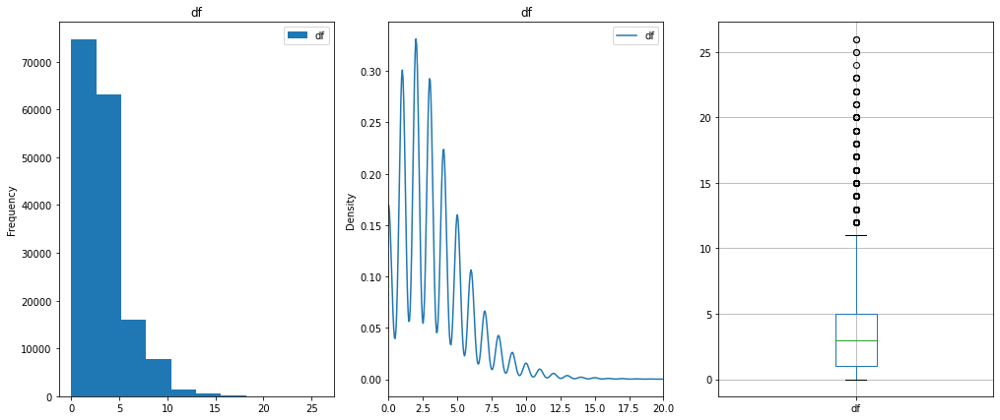

In [ ]:
df_median = merged_matches.df.median()
print("df over 26: "+str(merged_matches[merged_matches.df > 26]['df'].shape[0]))
merged_matches.loc[merged_matches.df > 26,'df'] = df_median
matches.loc[matches.l_df > 26,'l_df'] = df_median
matches.loc[matches.w_df > 26,'w_df'] = df_median

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['df'].plot.hist(title="df", ax=ax1)
merged_matches['df'].plot.kde(title="df", ax=ax2)
merged_matches.boxplot(column=['df'],ax=ax3)
print(merged_matches['df'].describe())
ax2.set_xlim(0,20)
ax1.legend()
ax2.legend()
plt.show()

Every 9.7 second serve 1 douple fault appear, this statistics came from https://www.atptour.com/en/news/federer-infosys-second-serves-october-2017.
In average in a match there are 50-200 serves.
The problem is that we don't have a way to infer the second serve without using double fault.
So we decided to truncate over 26 double faults according to the Most double faults in a match from wikipedia performed by Alexander Bublik.
https://en.wikipedia.org/wiki/Double_fault_(tennis)


## Serve points

count    163964.000000
mean         72.394739
std          24.173932
min           0.000000
25%          55.000000
50%          68.000000
75%          88.000000
max         250.000000
Name: svpt, dtype: float64


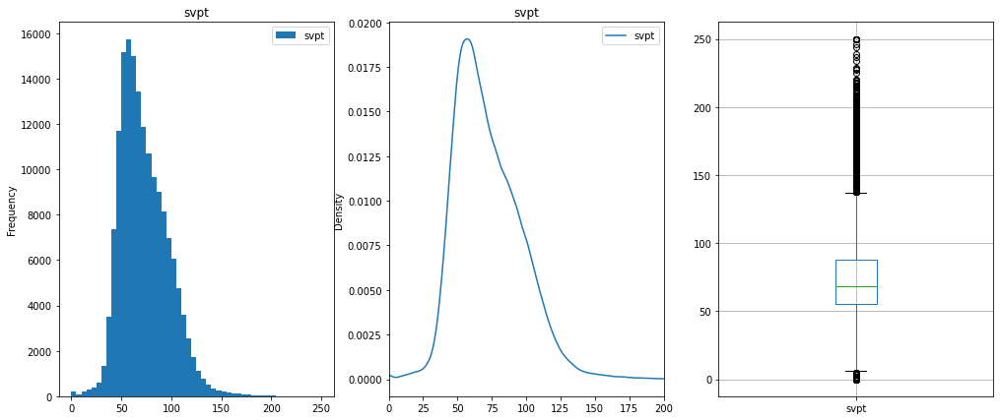

In [ ]:
svpt_th = 250
merged_matches.loc[merged_matches.svpt >  svpt_th,'svpt'] = svpt_th
matches.loc[matches.w_svpt > svpt_th,'w_svpt'] = svpt_th
matches.loc[matches.l_svpt > svpt_th,'l_svpt'] = svpt_th

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['svpt'].plot.hist(title="svpt", ax=ax1, bins=50)
merged_matches['svpt'].plot.kde(title="svpt", ax=ax2)
merged_matches.boxplot(column=['svpt'],ax=ax3)
print(merged_matches['svpt'].describe())
ax2.set_xlim(0,200)
ax1.legend()
ax2.legend()
plt.show()

https://www.ultimatetennisstatistics.com/playerProfile?playerId=4920&tab=statistics
As we can see in utimatetennisstatistics.com looking at Novak Djokovic one of the best players, the average svp of him is around 160.
Also from this website https://www.mattspoint.com/blog/an-interval-serve-program-for-elite-tennis we saw that
on average, professional males attempt 157 serves/match while females attempt 96 serves/match. The data was taken from the US Open, which for the men, are comprised of 5-set matches. On average, junior males attempt 94 serves/match while junior females attempt 86 serves/match.
 Since these are the mean of svpt there can be possible that a single match is over these values. To choose the threshold we can see from the box plot that there are few points over 250 (12 points) so we have decided to use this value to remove outliers.

## 1stIn

count    163964.000000
mean         44.397130
std          16.203375
min           0.000000
25%          33.000000
50%          42.000000
75%          54.000000
max         250.000000
Name: 1stIn, dtype: float64


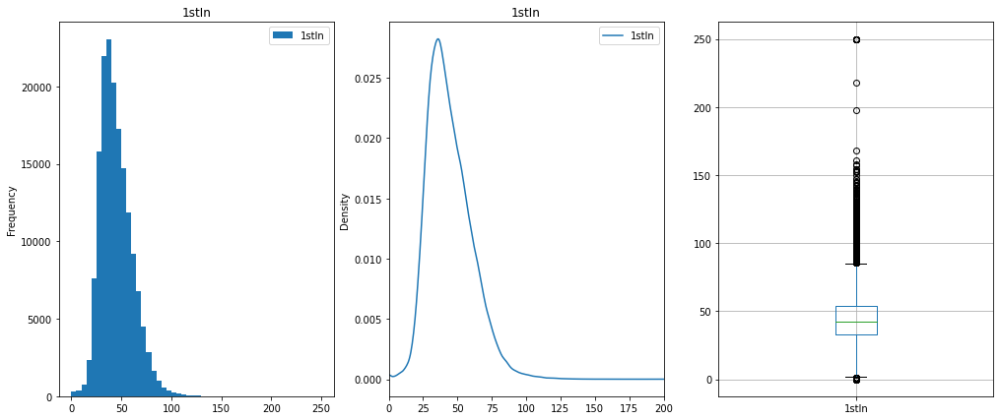

In [ ]:
f1stIn = 250
merged_matches.loc[merged_matches['1stIn'] >  svpt_th,'1stIn'] = f1stIn
matches.loc[matches.w_1stIn > svpt_th,'w_1stIn'] = f1stIn
matches.loc[matches.l_1stIn > svpt_th,'l_1stIn'] = f1stIn

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['1stIn'].plot.hist(title="1stIn", ax=ax1, bins=50)
merged_matches['1stIn'].plot.kde(title="1stIn", ax=ax2)
merged_matches.boxplot(column=['1stIn'],ax=ax3)
print(merged_matches['1stIn'].describe())
ax2.set_xlim(0,200)
ax1.legend()
ax2.legend()
plt.show()

## 1stWon

number of outliers: 8
count    163964.000000
mean         30.085250
std          11.744286
min           0.000000
25%          22.000000
50%          29.000000
75%          37.000000
max         205.000000
Name: 1stWon, dtype: float64


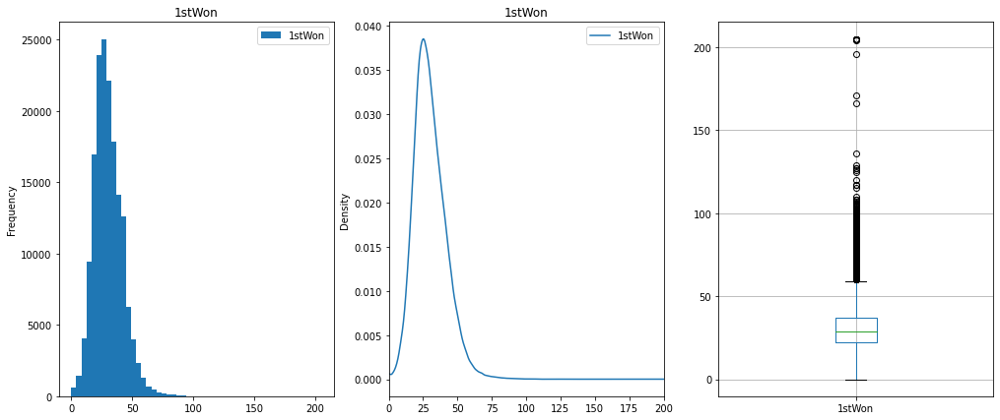

In [ ]:
f1stWon = 250*0.82 # 82%
print("number of outliers: "+str(merged_matches[merged_matches['1stWon'] >  f1stWon].shape[0]))
merged_matches.loc[merged_matches['1stWon'] >  f1stWon,'1stWon'] = f1stWon
matches.loc[matches.w_1stWon > f1stWon,'w_1stWon'] = f1stWon
matches.loc[matches.l_1stWon > f1stWon,'l_1stWon'] = f1stWon

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['1stWon'].plot.hist(title="1stWon", ax=ax1, bins=50)
merged_matches['1stWon'].plot.kde(title="1stWon", ax=ax2)
merged_matches.boxplot(column=['1stWon'],ax=ax3)
print(merged_matches['1stWon'].describe())
ax2.set_xlim(0,200)
ax1.legend()
ax2.legend()
plt.show()

From this website https://www.atptour.com/en/stats/1st-serve-points-won?page=1&sortByField=percentage&ascending=False. we took the information about player with the highest percentace of 1st serve points won. With this information and the information about the total number of matches we computed the average 1st serve won of the best player (45.80 per match).
We decided to set a treshold according also to the previus analysis on FirstIn where we have chosen 250 as threshold, since the percentage of 1stwon over 1stin is ~82% we take the 82% of 250. 


## 2ndWon

number of outliers: 7
count    163964.000000
mean         13.582463
std           6.047531
min           0.000000
25%           9.000000
50%          13.000000
75%          17.000000
max          57.000000
Name: 2ndWon, dtype: float64


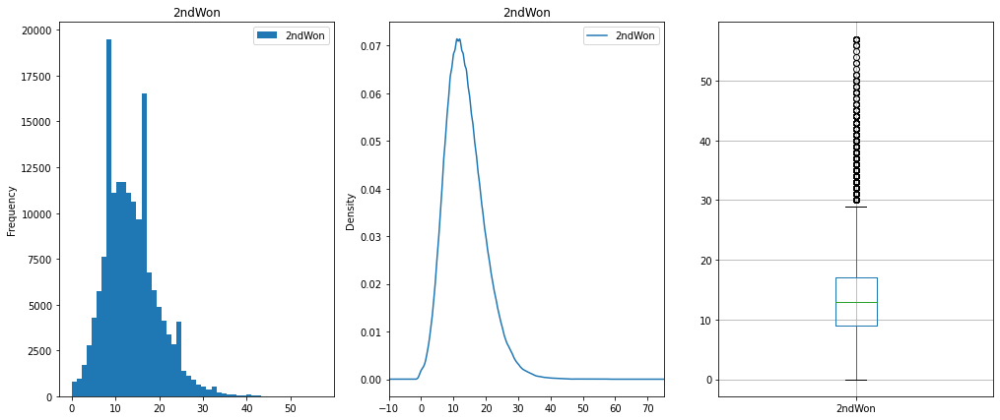

In [ ]:
s2ndWon = 250 * 0.4 * 0.57
print("number of outliers: "+str(merged_matches[merged_matches['2ndWon'] >  s2ndWon].shape[0]))
merged_matches.loc[merged_matches['2ndWon'] >  s2ndWon,'2ndWon'] = s2ndWon
matches.loc[matches.w_2ndWon > s2ndWon,'w_2ndWon'] = s2ndWon
matches.loc[matches.l_2ndWon > s2ndWon,'l_2ndWon'] = s2ndWon

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['2ndWon'].plot.hist(title="2ndWon", ax=ax1, bins=50)
merged_matches['2ndWon'].plot.kde(title="2ndWon", ax=ax2)
merged_matches.boxplot(column=['2ndWon'],ax=ax3)
print(merged_matches['2ndWon'].describe())
ax2.set_xlim(-10,75)
ax1.legend()
ax2.legend()
plt.show()

https://www.atptour.com/en/stats/1st-serve-points-won/all/all/all/?page=1&sortByField=percentage&ascending=True
prendiamo il numero dei 1stin (abbiamo assunto che al massimo sono uguali ai fisrst serve) - 60% che è la percentuale dei 1stwon (sui first serve) del "piu scarso" otteniamo quindi una sovrastima dei primi falli (contiene 1falli e 1stlose).
Adesso guardando la percentuale massima di 2ndwin = 57 (del piu forte sui second serve) possiamo quindi prendere il 57% di (1stin - 60%)

## BpFaced

number of outliers: 6
count    163964.000000
mean          7.130126
std           4.319705
min           0.000000
25%           4.000000
50%           7.000000
75%          10.000000
max          65.000000
Name: bpFaced, dtype: float64


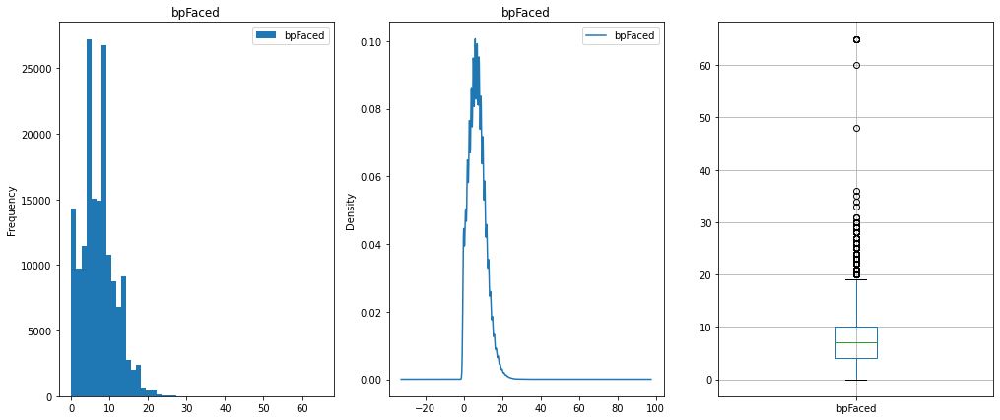

In [ ]:
bpFacedTh = 65
print("number of outliers: "+str(merged_matches[merged_matches.bpFaced>bpFacedTh].shape[0]))
merged_matches.loc[merged_matches['bpFaced'] >  bpFacedTh,'bpFaced'] = bpFacedTh
matches.loc[matches.w_bpFaced > bpFacedTh,'w_bpFaced'] = bpFacedTh
matches.loc[matches.l_bpFaced > bpFacedTh,'l_bpFaced'] = bpFacedTh

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['bpFaced'].plot.hist(title="bpFaced", ax=ax1, bins=50)
merged_matches['bpFaced'].plot.kde(title="bpFaced", ax=ax2)
merged_matches.boxplot(column=['bpFaced'],ax=ax3)
print(merged_matches['bpFaced'].describe())
ax1.legend()
ax2.legend()
plt.show()

https://www.ultimatetennisstatistics.com/topMatchStats Sortando per Break point faced per set sui match al meglio di 3 otteniamo come valore 18 per set, mentre al meglio di 5 per sett abbiamo 13. Quindi possiamo avere una stima del limite superiore pari al max(18\*3,13\*5) = 65.
Utilizziamo quindi questo valore come threshold.

## BpSaved

number of outliers: 5
count    163964.000000
mean          4.096637
std           3.114430
min           0.000000
25%           2.000000
50%           4.000000
75%           6.000000
max          65.000000
Name: bpSaved, dtype: float64


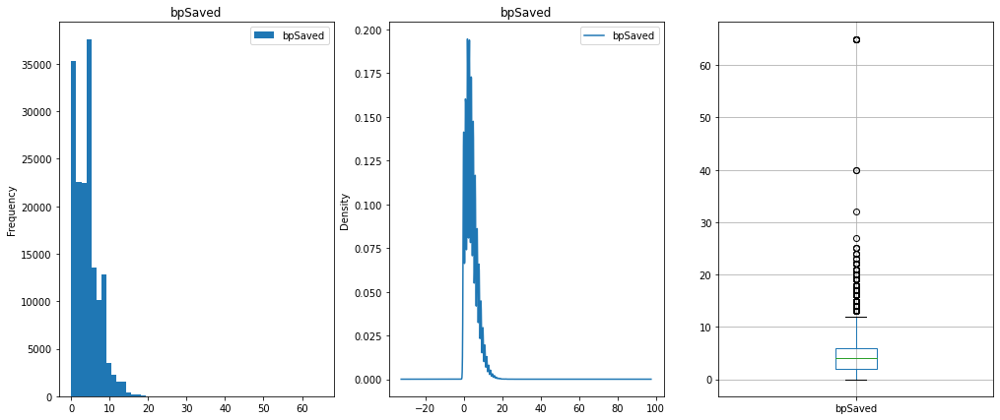

In [ ]:
bpSavedTh = 65
print("number of outliers: "+str(merged_matches[merged_matches.bpSaved>bpSavedTh].shape[0]))
merged_matches.loc[merged_matches['bpSaved'] >  bpSavedTh,'bpSaved'] = bpSavedTh
matches.loc[matches.w_bpSaved > bpSavedTh,'w_bpSaved'] = bpSavedTh
matches.loc[matches.l_bpSaved > bpSavedTh,'l_bpSaved'] = bpSavedTh

fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['bpSaved'].plot.hist(title="bpSaved", ax=ax1, bins=50)
merged_matches['bpSaved'].plot.kde(title="bpSaved", ax=ax2)
merged_matches.boxplot(column=['bpSaved'],ax=ax3)
print(merged_matches['bpSaved'].describe())
ax1.legend()
ax2.legend()
plt.show()

## IOC

Abbiamo trovato un errore nelle nazioni nello specifico esistono GER - DEU per indicare la Germania e GRE - GRC per indicare la Grecia. Abbiamo deciso di unirli.

In [ ]:
print(merged_matches.ioc.value_counts().index.tolist())
print("Number of country codes: "+str(len(merged_matches.ioc.value_counts().index.tolist())))

['USA', 'FRA', 'ITA', 'GER', 'ESP', 'RUS', 'AUS', 'ARG', 'JPN', 'CZE', 'CHN', 'SRB', 'GBR', 'BEL', 'BRA', 'CAN', 'SVK', 'CRO', 'SUI', 'UKR', 'ROU', 'NED', 'KAZ', 'AUT', 'BLR', 'POL', 'IND', 'POR', 'TPE', 'SLO', 'SWE', 'COL', 'KOR', 'CHI', 'HUN', 'BIH', 'BUL', 'ECU', 'LAT', 'TUR', 'UZB', 'GRE', 'RSA', 'DEN', 'TUN', 'MEX', 'EST', 'ISR', 'DOM', 'GEO', 'NOR', 'MDA', 'URU', 'EGY', 'LTU', 'THA', 'PER', 'FIN', 'LUX', 'BOL', 'NZL', 'PUR', 'CYP', 'ESA', 'BAR', 'MNE', 'IRL', 'VEN', 'PAR', 'MON', 'ZIM', 'INA', 'MAR', 'PHI', 'HKG', 'PAK', 'VIE', 'LIE', 'GUA', 'KGZ', 'SRI', 'MAS', 'SIN', 'IRI', 'QAT', 'BAH', 'ALG', 'HAI', 'OMA', 'BRN', 'PNG', 'TKM', 'CRC', 'TRI', 'SGP', 'MKD', 'HON', 'CUB', 'PAN', 'LIB', 'POC', 'SAM', 'MGL', 'TJK', 'GUM', 'KUW', 'MAD', 'BER', 'BDI', 'COD', 'ANT', 'UAE', 'PHL', 'LBA', 'TOG', 'AND', 'ERI', 'LBN', 'ITF', 'SMR', 'BEN', 'GUD', 'SYR', 'AHO', 'UNK']
Number of country codes: 125


Abbiamo scoperto che alcune nazionalità utilizzano ISO3166-1-Alpha3 altre FIFA.
Ci sono anche degli IOC di cui non abbiamo trovato riscontro ['UNK', 'POC', 'MRN', 'ITF'].
Per lo ioc UNK abbiamo trovato 11 player a cui abbiamo sistemato manualmente la nazionalità  
Le abbiamo individuate e corrette mendiante un csv esterno.

In [ ]:
country_codes = pd.read_csv('drive/MyDrive/dm_dataset/country_codes.csv')
country_codes.head()

,FIFA,Dial,ISO3166-1-Alpha-3,MARC,is_independent,ISO3166-1-numeric,GAUL,FIPS,WMO,ISO3166-1-Alpha-2,ITU,IOC,DS,UNTERM Spanish Formal,Global Code,Intermediate Region Code,official_name_fr,UNTERM French Short,ISO4217-currency_name,Developed / Developing Countries,UNTERM Russian Formal,UNTERM English Short,ISO4217-currency_alphabetic_code,Small Island Developing States (SIDS),UNTERM Spanish Short,ISO4217-currency_numeric_code,UNTERM Chinese Formal,UNTERM French Formal,UNTERM Russian Short,M49,Sub-region Code,Region Code,official_name_ar,ISO4217-currency_minor_unit,UNTERM Arabic Formal,UNTERM Chinese Short,Land Locked Developing Countries (LLDC),Intermediate Region Name,official_name_es,UNTERM English Formal,official_name_cn,official_name_en,ISO4217-currency_country_name,Least Developed Countries (LDC),Region Name,UNTERM Arabic Short,Sub-region Name,official_name_ru,Global Name,Capital,Continent,TLD,Languages,Geoname ID,CLDR display name,EDGAR
0,TPE,886,TWN,ch,Yes,158.0,925,TW,,TW,,TPE,RC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Taipei,AS,.tw,"zh-TW,zh,nan,hak",1668284.0,Taiwan,NaN
1,AFG,93,AFG,af,Yes,4.0,1,AF,AF,AF,AFG,AFG,AFG,República Islámica del Afganistán (la),True,NaN,Afghanistan,Afghanistan (l') [masc.],Afghani,Developing,Исламская Республика Афганистан,Afghanistan,AFN,NaN,Afganistán (el),971,阿富汗伊斯兰共和国,République islamique d'Afghanistan,Афганистан,4.0,34.0,142.0,أفغانستان,2,جمهورية أفغانستان الإسلامية,阿富汗,x,NaN,Afganistán,the Islamic Republic of Afghanistan,阿富汗,Afghanistan,AFGHANISTAN,x,Asia,أفغانستان,Southern Asia,Афганистан,World,Kabul,AS,.af,"fa-AF,ps,uz-AF,tk",1149361.0,Afghanistan,B2
2,ALB,355,ALB,aa,Yes,8.0,3,AL,AB,AL,ALB,ALB,AL,la República de Albania,True,NaN,Albanie,Albanie (l') [fém.],Lek,Developed,Республика Албания,Albania,ALL,NaN,Albania,008,阿尔巴尼亚共和国,la République d'Albanie,Албания,8.0,39.0,150.0,ألبانيا,2,جمهورية ألبانيا,阿尔巴尼亚,NaN,NaN,Albania,the Republic of Albania,阿尔巴尼亚,Albania,ALBANIA,NaN,Europe,ألبانيا,Southern Europe,Албания,World,Tirana,EU,.al,"sq,el",783754.0,Albania,B3
3,ALG,213,DZA,ae,Yes,12.0,4,AG,AL,DZ,ALG,ALG,DZ,la República Argelina Democrática y Popular,True,NaN,Algérie,Algérie (l') [fém.],Algerian Dinar,Developing,Алжирская Народная Демократическая Республика,Algeria,DZD,NaN,Argelia,012,阿尔及利亚民主人民共和国,la République algérienne démocratique et popul...,Алжир,12.0,15.0,2.0,الجزائر,2,الجمهورية الجزائرية الديمقراطية الشعبية,阿尔及利亚,NaN,NaN,Argelia,the People's Democratic Republic of Algeria,阿尔及利亚,Algeria,ALGERIA,NaN,Africa,الجزائر,Northern Africa,Алжир,World,Algiers,AF,.dz,ar-DZ,2589581.0,Algeria,B4
4,ASA,1-684,ASM,as,Territory of US,16.0,5,AQ,,AS,SMA,ASA,USA,NaN,True,NaN,Samoa américaines,NaN,US Dollar,Developing,NaN,NaN,USD,x,NaN,840,NaN,NaN,NaN,16.0,61.0,9.0,ساموا الأمريكية,2,NaN,NaN,NaN,NaN,Samoa Americana,NaN,美属萨摩亚,American Samoa,AMERICAN SAMOA,NaN,Oceania,NaN,Polynesia,Американское Самоа,World,Pago Pago,OC,.as,"en-AS,sm,to",5880801.0,American Samoa,B5


In [ ]:
country_codes = country_codes[['ISO3166-1-Alpha-3','IOC','FIFA','ITU', 'UNTERM English Formal', 'official_name_en' ,'UNTERM English Short']]
players_iocs  = merged_matches.ioc.value_counts().index.tolist()
not_ioc = filter(lambda x: x not in country_codes['IOC'].values, players_iocs)
l_not_ioc = list(not_ioc)
print(l_not_ioc)
not_alpha = filter(lambda x: x not in country_codes['ISO3166-1-Alpha-3'].values, l_not_ioc)
not_alpha = list(not_alpha)
print(not_alpha)
not_listed = filter(lambda x: x not in country_codes['FIFA'].values, not_alpha)
not_listed= list(not_listed)
print(not_listed)
matches['winner_ioc'] = matches['winner_ioc'].apply(lambda x: country_codes[country_codes.FIFA==x]['IOC'].values[0] if x in (country_codes.FIFA.values) else x)
matches['winner_ioc'] = matches['winner_ioc'].apply(lambda x: country_codes[country_codes.ITU==x]['IOC'].values[0] if x in (country_codes.ITU.values) else x)
matches['winner_ioc'] = matches['winner_ioc'].apply(lambda x: country_codes[country_codes['ISO3166-1-Alpha-3']==x]['IOC'].values[0] if x in (country_codes['ISO3166-1-Alpha-3'].values) else x)
matches['loser_ioc'] = matches['loser_ioc'].apply(lambda x: country_codes[country_codes.FIFA==x]['IOC'].values[0] if x in (country_codes.FIFA.values) else x)
matches['loser_ioc'] = matches['loser_ioc'].apply(lambda x: country_codes[country_codes.ITU==x]['IOC'].values[0] if x in (country_codes.ITU.values) else x)
matches['loser_ioc'] = matches['loser_ioc'].apply(lambda x: country_codes[country_codes['ISO3166-1-Alpha-3']==x]['IOC'].values[0] if x in (country_codes['ISO3166-1-Alpha-3'].values) else x)


['MNE', 'TRI', 'SGP', 'POC', 'PHL', 'LBN', 'ITF', 'UNK']
['TRI', 'POC', 'ITF', 'UNK']
['POC', 'ITF', 'UNK']


In [ ]:
print(merged_matches[merged_matches['ioc'] == 'UNK'][['id','name']].drop_duplicates())
print(merged_matches[merged_matches['ioc'] == 'POC'][['id','name']].drop_duplicates())
print(merged_matches[merged_matches['ioc'] == 'MRN'][['id','name']].drop_duplicates())
print(merged_matches[merged_matches['ioc'] == 'ITF'][['id','name']].drop_duplicates())

            id        name
103853  208510  xinmu zhou
            id                 name
86247  0221803  carol young suh lee
86712  0215859           mayka zima
86713  0221811        ayana rengiil
98038  0221802        violet apisah
Empty DataFrame
Columns: [id, name]
Index: []
           id                 name
72194  206839  filippo piranomonte


In [ ]:
correct_ioc = [
    ('208510','CHN'),
    ('0215859','NCD'),
    ('0221802','PNG'),
    ('0221803','NMA'),
    ('0221811','PLW'),
    ('206839','ITA')
    
]
for (idd,ioc) in correct_ioc:
    matches.loc[matches['winner_id']== idd, 'winner_ioc']= ioc
    matches.loc[matches['loser_id']== idd, 'loser_ioc']= ioc

## Ages

There are a lot of players with different ages. This is normal because the time span is 5 years so each players ages chang year by year.

In [ ]:
merged_matches[merged_matches.age.notna()][['id','age']].groupby('id').agg(lambda x: len(set(x)) > 1).reset_index()

,id,age
0,0200002,True
1,0200033,True
2,0200043,True
3,0200067,True
4,0200079,True
...,...,...
4194,210086,False
4195,210087,True
4196,210097,False
4197,210117,False


So we have decided to convert the age in born date in order to have an unique value that doesn't change over time.

In [ ]:
ages = merged_matches[merged_matches.age.notna()][['id','tourney_date','age']]
ages.age = ages.age.apply(lambda x: np.round(x)) #approssimiamo sopra poichè age con la virgola indica quanto manca al compimento nel compleanno.
ages.tourney_date = ages.tourney_date.apply(lambda x: int(str(x)[:4])) #fro float taking the first 4 number converted as string ed 2018 
ages['born_date'] = ages.tourney_date - ages.age 
ages = ages[ages.born_date.notna()][['id','born_date']].groupby('id').agg(lambda x: x.value_counts().index.tolist()[0]).reset_index()
#ages['id'] = ages['id'].astype(int).astype(str)
ages['born_date'] = ages['born_date'].astype(int)
ages.head()

,id,born_date
0,0200002,1982
1,0200033,1981
2,0200043,1983
3,0200067,1978
4,0200079,1983


In [ ]:
ages = ages.rename(columns={"born_date": "w_born_date"})
matches = pd.merge(matches,ages,left_on='winner_id',right_on='id',how='left')
ages = ages.rename(columns={"w_born_date": "l_born_date"})
matches = pd.merge(matches,ages,left_on='loser_id',right_on='id',how='left')
matches = matches.drop(columns=['id_x', 'id_y'])
print(matches.columns)

Index(['tourney_id', 'tourney_name', 'surface', 'draw_size', 'tourney_level',
       'tourney_date', 'match_num', 'winner_id', 'winner_entry', 'winner_name',
       'winner_hand', 'winner_ht', 'winner_ioc', 'winner_age', 'loser_id',
       'loser_entry', 'loser_name', 'loser_hand', 'loser_ht', 'loser_ioc',
       'loser_age', 'score', 'best_of', 'round', 'minutes', 'w_ace', 'w_df',
       'w_svpt', 'w_1stIn', 'w_1stWon', 'w_2ndWon', 'w_SvGms', 'w_bpSaved',
       'w_bpFaced', 'l_ace', 'l_df', 'l_svpt', 'l_1stIn', 'l_1stWon',
       'l_2ndWon', 'l_SvGms', 'l_bpSaved', 'l_bpFaced', 'winner_rank',
       'winner_rank_points', 'loser_rank', 'loser_rank_points',
       'tourney_spectators', 'tourney_revenue', 'w_gender', 'l_gender',
       'w_born_date', 'l_born_date'],
      dtype='object')


Reguards missing value for born date we decided to use the median of female if the player is a female male otherwise.

In [ ]:
ages = ages.rename(columns={"l_born_date": "born_date"})
id_gender = merged_matches[['id','gender']].groupby('id').agg(max).reset_index()
id_gender_born_date = pd.merge(id_gender,ages,on='id',how='left')
print("Missing values for born date: "+str(id_gender_born_date.born_date.isna().sum()))

Missing values for born date: 58


In [ ]:
matches.loc[(matches.w_born_date.isna()) & (matches.w_gender=='Male'), 'w_born_date'] =  id_gender_born_date[(~id_gender_born_date.born_date.isna()) & (id_gender_born_date.gender=='Male')]['born_date'].median()
matches.loc[(matches.w_born_date.isna()) & (matches.w_gender=='Female'), 'w_born_date'] =  id_gender_born_date[(~id_gender_born_date.born_date.isna()) & (id_gender_born_date.gender=='Female')]['born_date'].median()
matches.loc[(matches.l_born_date.isna()) & (matches.w_gender=='Female'), 'l_born_date'] =  id_gender_born_date[(~id_gender_born_date.born_date.isna()) & (id_gender_born_date.gender=='Female')]['born_date'].median()
matches.loc[(matches.l_born_date.isna()) & (matches.w_gender=='Male'), 'l_born_date'] =  id_gender_born_date[(~id_gender_born_date.born_date.isna()) & (id_gender_born_date.gender=='Male')]['born_date'].median()
print(matches.l_born_date.isna().sum())
print(matches.w_born_date.isna().sum())

0
0


## Height

In [ ]:
hts = merged_matches[merged_matches.ht.notna()][['id', 'ht']].groupby('id').agg(lambda x: len(set(x)) > 1).reset_index()
print(merged_matches[merged_matches['id'] == '105676'].groupby('id').agg({'ht':'value_counts'}))
matches.loc[matches['winner_id'] == '105676', 'winner_ht'] = 180
matches.loc[matches['loser_id'] == '105676', 'loser_ht'] = 180

               ht
id     ht        
105676 180.0  161
       163.0  156


abbiamo individuato un player con due differenti altezze: 180, 163, cercando su internet abbiamo visto che l'altezza esatta è 180 e quindi l'abbiamo corretta. Riguardo al massimo ovvero 2.11 metri il dato è corretto ed è il giocatore ivo karlovic https://www.atptour.com/en/players/ilija-vucic/v624/overview. 

id       name               ht 
0215872  kamilla rakhimova  2.0    12
dtype: int64
count    77161.000000
mean       182.493721
std          8.957115
min        155.000000
25%        177.000000
50%        183.000000
75%        188.000000
max        211.000000
Name: ht, dtype: float64


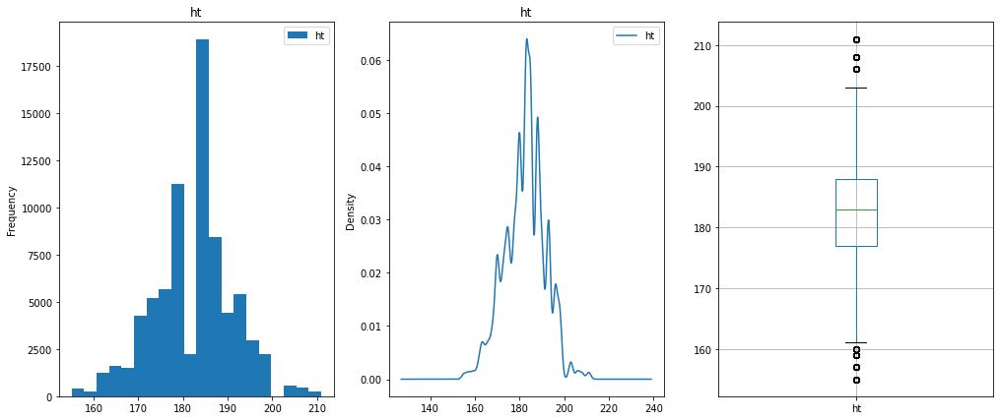

In [ ]:
print(merged_matches[merged_matches['ht'] <10].groupby(['id','name', 'ht']).size())
merged_matches.loc[merged_matches['id'] == '0215872', 'ht'] = 174 # kamilla rakhimova player with height 2.
merged_matches.loc[merged_matches['id'] == '105661', 'ht'] = 188 #ilija vucic wrong height from 145->188.
matches.loc[matches['winner_id']=='0215872', 'winner_ht' ] = 174
matches.loc[matches['loser_id']=='0215872', 'loser_ht' ] = 174
matches.loc[matches['winner_id']=='105661', 'winner_ht' ] = 188
matches.loc[matches['loser_id']=='105661', 'loser_ht' ] = 188


fig, (ax1,ax2,ax3) = plt.subplots(1,3,figsize=(17,7))
merged_matches['ht'].plot.hist(title="ht", ax=ax1, bins=20)
merged_matches['ht'].plot.kde(title="ht", ax=ax2)
merged_matches.boxplot(column=['ht'],ax=ax3)
print(merged_matches['ht'].describe())
ax1.legend()
ax2.legend()
plt.show()

Managing missing values for Height.

We can see in the code below that the height almost empty. We have only the 12% of players with height. 

In [ ]:
merged_matches[['id','ht']].groupby('id').aggregate(max).reset_index().info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4257 entries, 0 to 4256
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   id      4257 non-null   object 
 1   ht      534 non-null    float64
dtypes: float64(1), object(1)
memory usage: 66.6+ KB


To deal with this missing values, we wanted to use some distribution to fill this values but the problem is that we cannot use our data because they are very few and the mean and std will be very weak. So at the first attempt we tried a external csv file that contains all the female and male height by country.

In [ ]:
heights_by_country = pd.read_csv('drive/MyDrive/dm_dataset/height_dataset.csv',  sep=r'\s*,\s*')
for i, col in enumerate(heights_by_country.columns):
    heights_by_country.iloc[:, i] = heights_by_country.iloc[:, i].str.replace('"', '')
heights_by_country.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  """Entry point for launching an IPython kernel.


,country,"""meanHeightMale""","""meanHeightFemale"""
0,Netherlands,183.7824,170.3612
1,Montenegro,183.3022,169.9609
2,Estonia,182.7907,168.6628
3,Bosnia and Herzegovina,182.4740,167.4704
4,Iceland,182.1016,168.9135


And by using the other external file with all the IOC country code and names we wanted to map the players ioc with the ioc dataframe to get the country name e match the country name with the height dataset to get the mean and height of people by country. This approach is teoretical wrong because we are filling the height of tennis players with the height of the average people of the same country as the player. This is wrong because the thennis player in average are taller than the mean so by doing this we will loose all the caractheristics of the height of the tennis playes. So we decided to leave this feature as it is without managing the missing values.

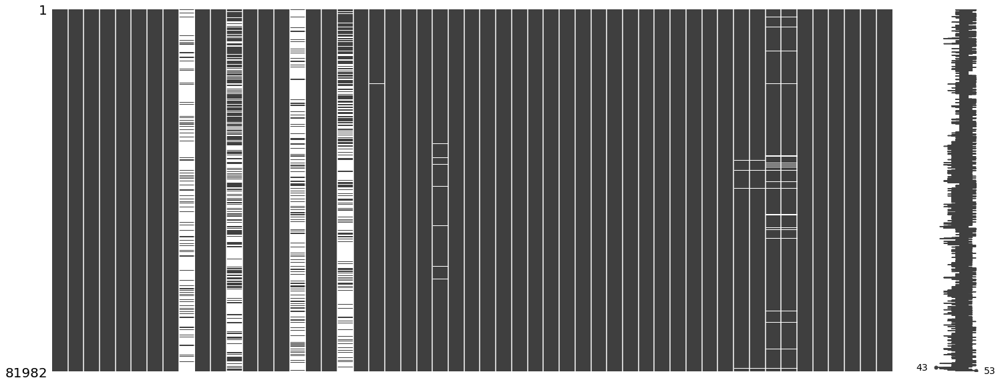

In [ ]:
msno.matrix(matches)
plt.show()

In [ ]:
matches.columns

Index(['tourney_id', 'tourney_name', 'surface', 'draw_size', 'tourney_level',
       'tourney_date', 'match_num', 'winner_id', 'winner_entry', 'winner_name',
       'winner_hand', 'winner_ht', 'winner_ioc', 'winner_age', 'loser_id',
       'loser_entry', 'loser_name', 'loser_hand', 'loser_ht', 'loser_ioc',
       'loser_age', 'score', 'best_of', 'round', 'minutes', 'w_ace', 'w_df',
       'w_svpt', 'w_1stIn', 'w_1stWon', 'w_2ndWon', 'w_SvGms', 'w_bpSaved',
       'w_bpFaced', 'l_ace', 'l_df', 'l_svpt', 'l_1stIn', 'l_1stWon',
       'l_2ndWon', 'l_SvGms', 'l_bpSaved', 'l_bpFaced', 'winner_rank',
       'winner_rank_points', 'loser_rank', 'loser_rank_points',
       'tourney_spectators', 'tourney_revenue', 'w_gender', 'l_gender',
       'w_born_date', 'l_born_date'],
      dtype='object')

## Tourney_id & Round

parsa id -> controlla stesso id e nome diverso
nel nome c'è scritto il round
davis cup: parsa nome fino a:
davis cup: PO R1 R2 R3 QF SF F
davis cup: WG (Finals dal 2019), WG1 WG2,, G1 G2, QLS
fed cup: WG, WG1 WG2, G1 G2
fed cup: parsa nome fino a:
fed cup si chiama bjk dal 2021

In [ ]:
def tourney_parse(row):
  if ~(row['tourney_name'] == np.nan) & (':' in str(row['tourney_name'])):
      row['tourney_name'] = str(row['tourney_name']).split(':')[0]
      s = re.search("(.*) (F|SF|RR|PO|R\d|QF|Playoffs|PM|PPO|REL)$",str(row['tourney_name']))
      row['round'] = s.group(2)
      row['tourney_name'] = s.group(1)
      row['tid'] = str(row['tourney_id']).split('-')[0] +'-'+ row['tourney_name']
      row['tid'] = re.sub(" ", '-', row['tid'])
  return row

prec = matches[~(matches['tourney_name'].isna()) & (matches['tourney_name'].str.contains(':'))]
matches = matches.apply(lambda row: tourney_parse(row), axis=1)
matches[matches['tourney_id'].isin(prec['tourney_id'])].groupby('tid').agg(frozenset).reset_index()[['tid', 'round']]


,tid,round
0,2016-Davis-Cup-G1,"(R2, R1)"
1,2016-Davis-Cup-G2,"(R3, R2, R1)"
2,2016-Davis-Cup-WG,"(SF, PO, QF, F, R1)"
3,2016-Fed-Cup-G2,"(PPO, REL, PM, RR)"
4,2016-Fed-Cup-WG,"(SF, F, R1)"
5,2016-Fed-Cup-WG2,(R1)
6,2017-Davis-Cup-G1,"(R2, R1)"
7,2017-Davis-Cup-G2,"(R3, R2, R1)"
8,2017-Davis-Cup-WG,"(SF, PO, QF, F, R1)"
9,2017-Fed-Cup-G1,"(PPO, REL, PM, RR)"


In [ ]:
matches.loc[matches['tourney_id'].isin(prec['tourney_id']), 'tourney_id'] = matches[matches['tourney_id'].isin(prec['tourney_id'])]['tid']

In [ ]:
tt = matches[['tourney_id','tourney_name', 'tourney_level', 'round', 'draw_size']].groupby(['tourney_name', 'draw_size']).agg(frozenset).reset_index()[['round', 'draw_size']].drop_duplicates()
tt

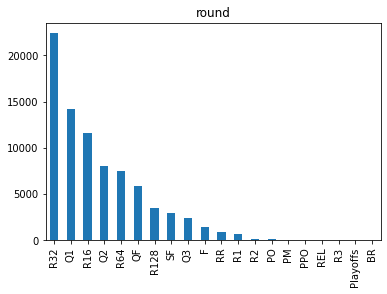

In [ ]:
matches['round'].value_counts().plot(kind='bar',title='round')
plt.show()

# Correlation

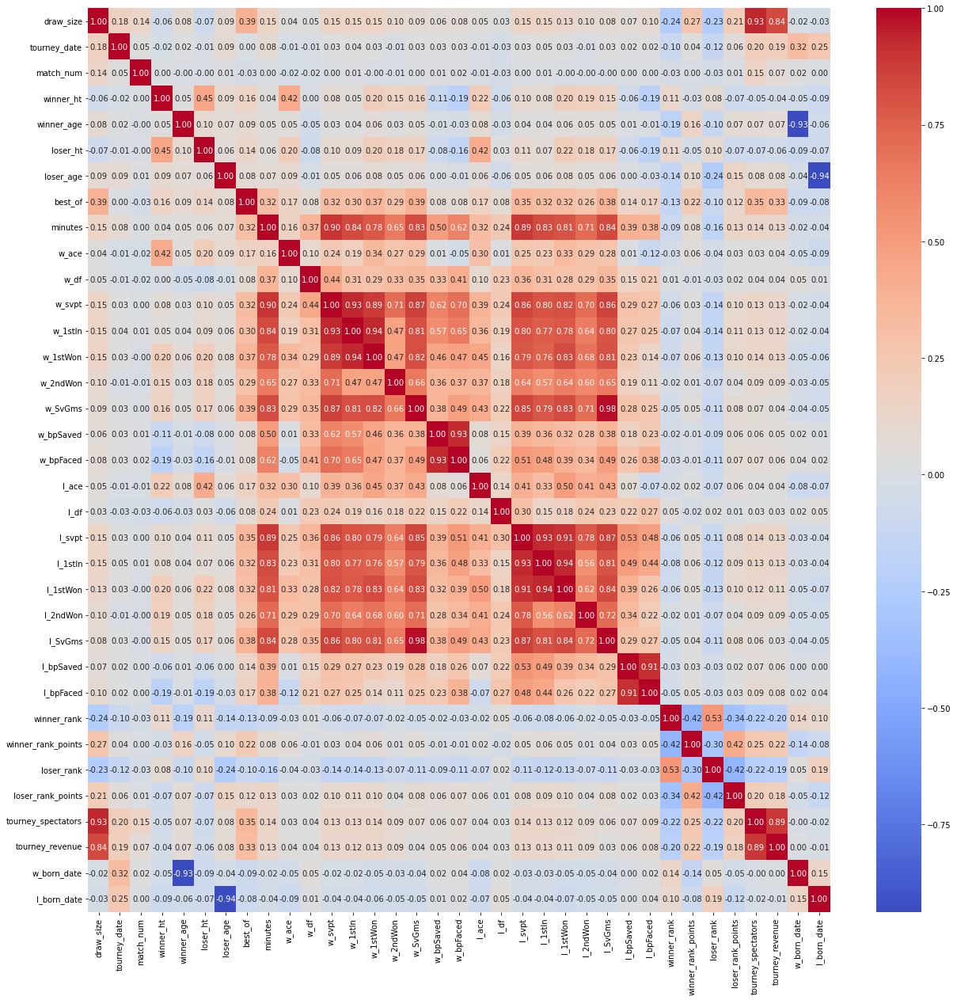

In [ ]:
import seaborn as sns
corr_matrix = matches.corr()
fig, ax = plt.subplots(figsize=(21,21))
sns.heatmap(corr_matrix, annot=True, fmt='.2f',cmap=plt.get_cmap('coolwarm'), cbar=True, ax=ax)
ax.set_yticklabels(ax.get_yticklabels(), rotation="horizontal")
plt.savefig('result.png', bbox_inches='tight', pad_inches=0.0)

In [ ]:
corr_matrix = matches.corr() #compute the correlation matrix
corr_matrix.style.background_gradient(cmap='coolwarm') #plot the correlation

,draw_size,tourney_date,match_num,winner_ht,winner_age,loser_ht,loser_age,best_of,minutes,w_ace,w_df,w_svpt,w_1stIn,w_1stWon,w_2ndWon,w_SvGms,w_bpSaved,w_bpFaced,l_ace,l_df,l_svpt,l_1stIn,l_1stWon,l_2ndWon,l_SvGms,l_bpSaved,l_bpFaced,winner_rank,winner_rank_points,loser_rank,loser_rank_points,tourney_spectators,tourney_revenue,w_born_date,l_born_date
draw_size,1.000000,0.178873,0.137585,-0.058495,0.079204,-0.074482,0.087570,0.389872,0.149129,0.042256,0.046010,0.147526,0.147035,0.152448,0.101645,0.088882,0.062828,0.075443,0.046469,0.034966,0.151269,0.146259,0.128505,0.097181,0.079885,0.068609,0.097118,-0.239613,0.267265,-0.231984,0.211360,0.932313,0.835847,-0.016958,-0.027397
tourney_date,0.178873,1.000000,0.045441,-0.016370,0.020927,-0.012611,0.090337,0.003687,0.080746,-0.014920,-0.009280,0.028397,0.043068,0.031918,-0.010604,0.028180,0.025558,0.033727,-0.012313,-0.027879,0.025465,0.045497,0.033268,-0.005145,0.026308,0.018093,0.019457,-0.104791,0.043691,-0.124973,0.055169,0.198919,0.191595,0.321346,0.252010
match_num,0.137585,0.045441,1.000000,0.001658,-0.000398,-0.001164,0.013191,-0.025610,0.003909,-0.021355,-0.020844,0.004316,0.011659,-0.000641,-0.009455,0.002634,0.010751,0.015911,-0.012617,-0.025890,0.000919,0.006146,-0.001341,-0.003258,-0.000152,0.002380,0.004995,-0.026850,0.000499,-0.033759,0.006043,0.153976,0.068205,0.016761,0.003438
winner_ht,-0.058495,-0.016370,0.001658,1.000000,0.045442,0.447847,0.092630,0.156328,0.042358,0.424934,0.000057,0.075196,0.052982,0.197160,0.154195,0.159849,-0.113320,-0.188581,0.218333,-0.064647,0.098573,0.082116,0.195181,0.185023,0.149626,-0.057040,-0.192221,0.109703,-0.028850,0.080243,-0.068549,-0.054320,-0.038854,-0.050764,-0.093736
winner_age,0.079204,0.020927,-0.000398,0.045442,1.000000,0.095153,0.071614,0.094937,0.053327,0.048257,-0.054963,0.030665,0.036707,0.063927,0.032295,0.049496,-0.014851,-0.027606,0.079464,-0.028762,0.044445,0.042803,0.059713,0.046470,0.049543,0.006204,-0.014203,-0.186489,0.159555,-0.097747,0.073176,0.072628,0.067498,-0.933932,-0.062444
loser_ht,-0.074482,-0.012611,-0.001164,0.447847,0.095153,1.000000,0.063646,0.139718,0.061370,0.201317,-0.076250,0.096750,0.093214,0.203194,0.176617,0.173365,-0.081776,-0.157906,0.417292,0.026434,0.112998,0.073223,0.215581,0.181489,0.169581,-0.056754,-0.185433,0.108716,-0.049596,0.104341,-0.069816,-0.071458,-0.057960,-0.092106,-0.070171
loser_age,0.087570,0.090337,0.013191,0.092630,0.071614,0.063646,1.000000,0.081535,0.069237,0.091854,-0.014832,0.054396,0.055226,0.075260,0.051069,0.064021,0.002821,-0.006689,0.063867,-0.058923,0.050459,0.057142,0.081538,0.046625,0.058372,0.002253,-0.030653,-0.142800,0.100717,-0.238352,0.145126,0.083613,0.078691,-0.037460,-0.937759
best_of,0.389872,0.003687,-0.025610,0.156328,0.094937,0.139718,0.081535,1.000000,0.318241,0.172606,0.079747,0.319564,0.304326,0.365631,0.285627,0.391209,0.084559,0.082244,0.168554,0.079444,0.349734,0.320137,0.317651,0.263765,0.377058,0.138080,0.168689,-0.130822,0.223401,-0.102895,0.120226,0.350720,0.333409,-0.088158,-0.078538
minutes,0.149129,0.080746,0.003909,0.042358,0.053327,0.061370,0.069237,0.318241,1.000000,0.163786,0.373622,0.900784,0.838747,0.784340,0.646696,0.831475,0.500297,0.620181,0.323724,0.236406,0.892661,0.829151,0.810322,0.712660,0.837108,0.394420,0.382550,-0.091654,0.076594,-0.161916,0.132049,0.138870,0.127189,-0.022597,-0.040123
w_ace,0.042256,-0.014920,-0.021355,0.424934,0.048257,0.201317,0.091854,0.172606,0.163786,1.000000,0.103752,0.240766,0.185351,0.342890,0.270179,0.293847,0.008122,-0.049706,0.298483,0.014444,0.248351,0.228708,0.329144,0.287674,0.278299,0.008133,-0.119483,-0.032178,0.055481,-0.037707,0.025333,0.034449,0.039276,-0.052087,-0.094859


# Visualizing correlated features

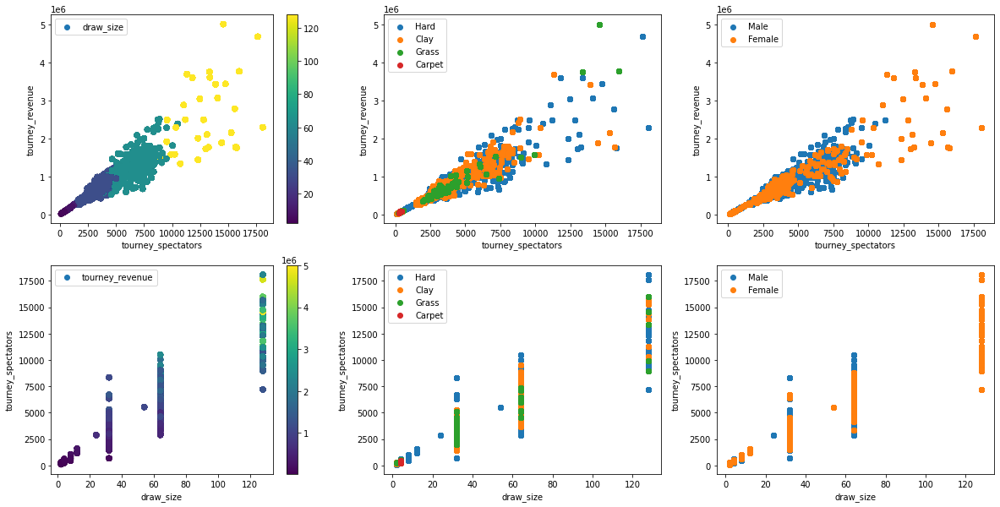

In [ ]:
fig, ax = plt.subplots(2,3,figsize=(20,10))
mc = ax[0][0].scatter(matches['tourney_spectators'], 
            matches['tourney_revenue'], c=matches['draw_size'], label='draw_size')
ax[0][0].set_xlabel('tourney_spectators')
ax[0][0].set_ylabel('tourney_revenue')
fig.colorbar(mc,ax=ax[0][0])
ax[0][0].legend()

for surf in matches["surface"].dropna().unique():
    ax[0][1].scatter(matches[matches['surface']== surf ]['tourney_spectators'], 
        matches[matches['surface']== surf]['tourney_revenue'],label=surf)
ax[0][1].set_xlabel('tourney_spectators')
ax[0][1].set_ylabel('tourney_revenue')
ax[0][1].legend()

for gender in matches["w_gender"].dropna().unique():
    ax[0][2].scatter(matches[matches['w_gender']== gender ]['tourney_spectators'], 
        matches[matches['w_gender']== gender]['tourney_revenue'], label=gender)
ax[0][2].set_xlabel('tourney_spectators')
ax[0][2].set_ylabel('tourney_revenue')
ax[0][2].legend()

cb10 = ax[1][0].scatter(matches['draw_size'], 
            matches['tourney_spectators'], c=matches['tourney_revenue'],label='tourney_revenue')
ax[1][0].set_xlabel('draw_size')
ax[1][0].set_ylabel('tourney_spectators')
fig.colorbar(cb10,ax=ax[1][0])
ax[1][0].legend()

for surf in matches["surface"].dropna().unique():
    ax[1][1].scatter(matches[matches['surface']== surf ]['draw_size'], 
        matches[matches['surface']== surf]['tourney_spectators'],label=surf)
ax[1][1].set_xlabel('draw_size')
ax[1][1].set_ylabel('tourney_spectators')
ax[1][1].legend()

for gender in matches["w_gender"].dropna().unique():
    ax[1][2].scatter(matches[matches['w_gender']== gender ]['draw_size'], 
        matches[matches['w_gender']== gender]['tourney_spectators'], label=gender)
ax[1][2].set_xlabel('draw_size')
ax[1][2].set_ylabel('tourney_spectators')
ax[1][2].legend()

plt.show()

In [ ]:
matches.w_gender.value_counts()

Male      58919
Female    23063
Name: w_gender, dtype: int64

In [ ]:
# Male earn more money than the girls in average.
print(matches[matches['w_gender']=='Female']['tourney_revenue'].mean())
print(matches[matches['w_gender']=='Male']['tourney_revenue'].mean())

# More spectators watching male than female.
print(matches[matches['w_gender']=='Female']['tourney_spectators'].mean())
print(matches[matches['w_gender']=='Male']['tourney_spectators'].mean())

1159753.5713246933
944006.3384346024
5854.397086242033
4715.162307574806


# Saving pkl

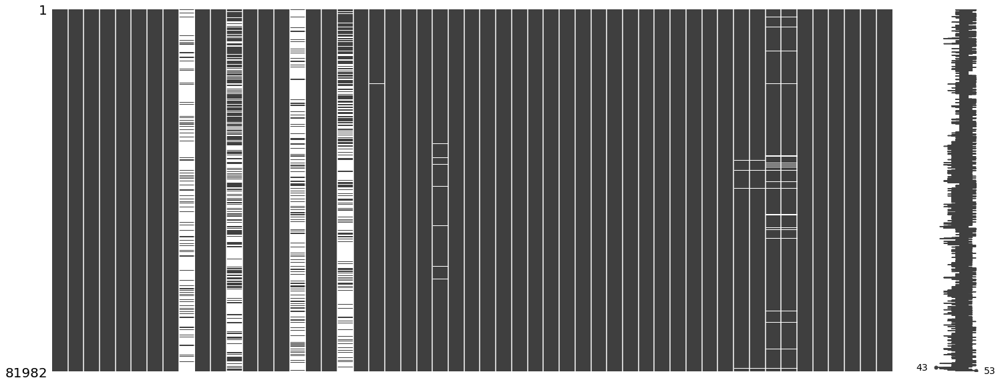

In [ ]:
msno.matrix(matches)
plt.show()

In [ ]:
matches.to_pickle('matches_tounery_id.pkl')

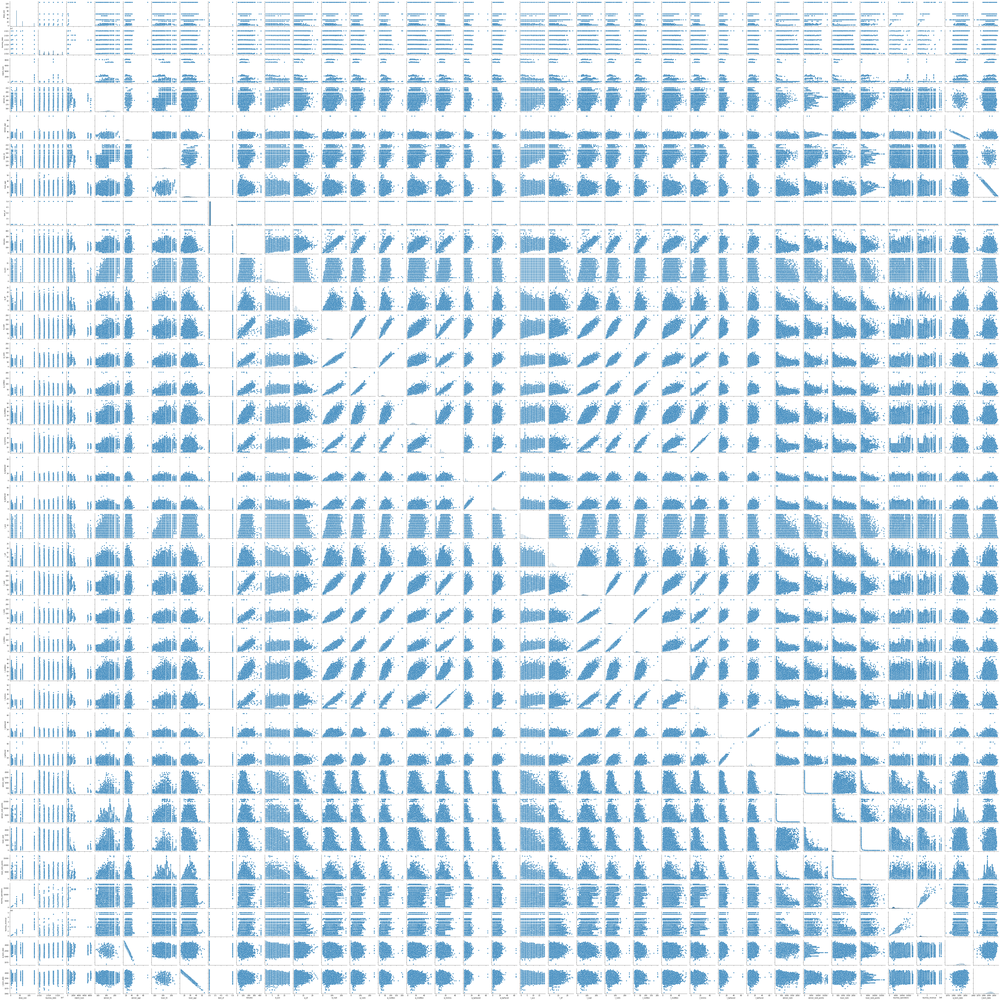

In [ ]:
import seaborn as sns
sns.pairplot(matches)